# `Практикум по программированию на языке Python`

## `Задание 02. Сегментация изображений`

#### Фамилия, имя:

Дата выдачи: <span style="color:red">__13 марта 01:00__</span>.

Мягкий дедлайн: <span style="color:red">__27 марта 23:59__</span>.

Стоимость: __10 баллов__ (основная часть заданий) + __4.25 балла__ (дополнительные задания).

<span style="color:red">__В ноутбуке все клетки должны выполняться без ошибок при последовательном их выполнении.__</span>

#### `Москва, 2024`

В этом задании вы будете решать задачу сегментации людей на фотографии с помощью нейросетевых архитектур `U-Net` и `LinkNet`.

Данные для выполнения задания можно скачать по [ссылке](https://disk.yandex.ru/d/tI6d3LBMHTwOnw).

## `Загрузка данных (1 балл)`

Для загрузки данных pytorch опирается на такую сущность, как **`Dataset`**.

Этот абстрактный класс определен в `torch.utils.data.dataset`:

```python
class Dataset(object):
    """An abstract class representing a Dataset.

    All other datasets should subclass it. All subclasses should override
    ``__len__``, that provides the size of the dataset, and ``__getitem__``,
    supporting integer indexing in range from 0 to len(self) exclusive.
    """

    def __getitem__(self, index):
        raise NotImplementedError

    def __len__(self):
        raise NotImplementedError

    def __add__(self, other):
        return ConcatDataset([self, other])
```
При определении нового источника данных мы создаем наследника данного класса и реализуем методы `__getitem__` и `__len__`.

Пример готового такого класса — `torchvision.datasets.ImageFolder`, который позволяет создать датасет на основе директории с ImageNet-подобной структурой поддиректорий (`./train/{class}` и `./val/{class}`):

```python
imagenet = torchvision.datasets.ImageFolder('path/to/imagenet_root/')
```

Реализуйте класс `PhotosDataset` для выданных данных.

**Внимание.** Возможно, стоит прочитать следующий пункт задания, чтобы реализация была удобной.

In [ ]:
import os
import glob

import numpy as np
import numpy.testing as npt

import torch
import torchvision
from torch.utils.data import Dataset, DataLoader
from torchvision.models import vgg13, VGG13_Weights

import matplotlib_inline
import matplotlib.pyplot as plt

from PIL import Image

%matplotlib inline
matplotlib_inline.backend_inline.set_matplotlib_formats('pdf', 'svg')

In [ ]:
!wget -nc -O dataset.zip https://www.dropbox.com/scl/fo/oae1qmjqs2gq2cjd50b3v/h?rlkey=22nsaq7bwkslmi2k1g7wd60j6&dl=1
!unzip -n -d dataset dataset.zip

--2024-04-04 19:49:42--  https://www.dropbox.com/scl/fo/oae1qmjqs2gq2cjd50b3v/h?rlkey=22nsaq7bwkslmi2k1g7wd60j6
Resolving www.dropbox.com (www.dropbox.com)... 162.125.2.18, 2620:100:6022:18::a27d:4212
Connecting to www.dropbox.com (www.dropbox.com)|162.125.2.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://uce24004ee1b69d96197041bc1f3.dl.dropboxusercontent.com/zip_download_get/Bzz0y1qH1UktAr4wqlcD3jb9oY2dJKuujsBpgMfXYSb6bACM74KGXjj4HcWKrXBoYi0fnsUP3DnJlQQ_i5dTi3epBsIOoca9oDOfDbZDGAYEag# [following]
--2024-04-04 19:49:46--  https://uce24004ee1b69d96197041bc1f3.dl.dropboxusercontent.com/zip_download_get/Bzz0y1qH1UktAr4wqlcD3jb9oY2dJKuujsBpgMfXYSb6bACM74KGXjj4HcWKrXBoYi0fnsUP3DnJlQQ_i5dTi3epBsIOoca9oDOfDbZDGAYEag
Resolving uce24004ee1b69d96197041bc1f3.dl.dropboxusercontent.com (uce24004ee1b69d96197041bc1f3.dl.dropboxusercontent.com)... 162.125.4.15, 2620:100:6017:15::a27d:20f
Connecting to uce24004ee1b69d96197041bc1f3.dl.dropboxusercontent.com (uce

In [ ]:
class PhotosDataset(Dataset):
    def __init__(self, images_dir, target_dir=None, transforms=None):
        """
        Arguments
        ---------
        images_dir : str
            Path to directory with images

        target_dir : str
            Path to directory with masks.
            Each mask corresponds to one image.
            Corresponding mask and image have the same name, but different format.

        transforms : some collection
            Sequence of transformations for images and masks.
        """
        self.images_dir = images_dir
        self.target_dir = target_dir
        self.transforms = transforms

    def __len__(self):
        return len(self.images_dir)

    def __getitem__(self, idx):
        """
        Arguments
        ---------
        idx : int
            Index of image and mask

        Returns
        -------
        (image, mask)
        """
        image_filepath = os.listdir(self.images_dir)[idx]
        image = Image.open(self.images_dir + '/' + image_filepath)

        if self.target_dir:
            target_filepath = os.listdir(self.target_dir)[idx]
            target_filepath = image_filepath.replace('jpg', 'png')
            target = Image.open(self.target_dir + '/' + target_filepath).convert("L")
        else:
            target = None

        if self.transforms:
            for transformer in self.transforms:
                image, target = transformer(image, target)

        if self.target_dir:
            return image, \
                torchvision.transforms.functional.pil_to_tensor(target).byte()
        else:
            return image,


## `Модуль аугментации (2 балла)`

Конструктор стандартного `ImageFolder`, принимает параметр `transform` (и иногда `target_transform`).

Они служат для того, чтобы загружаемые изображения (обычно это `PIL.Image`) или таргеты преобразовывать в тензоры нужного вида.

В `torchvision` входит модуль `transforms` для стандартных примеров таких преобразований. В `transforms` могут содержаться случайные преобразования, это самый простой путь для реализации аугментации данных.

При определении кастомного трансформера помимо конструктора нужно реализовать лишь метод `__call__`:

```python
class HorizontalFlip(object):
    def __init__(self, mode=0):
        self.method = mode

    def __call__(self, img):
        """
        Args:
            img (PIL.Image): Image to be flipped.

        Returns:
            PIL.Image: Randomly flipped image.
        """
        if self.method:
            return img.transpose(Image.FLIP_LEFT_RIGHT)
        return img

```

С полным списком стандартных преобразований можно ознакомиться в [документации](https://pytorch.org/vision/0.12/transforms.html).

В данной части вам предлагается самостоятельно реализовать несколько кастомных трансформеров.
Обратите внимание, что для некоторых трансформеров, необходимо преобразовывать и изображение, и маску, а для каких-то только изображение.

Один из путей реализации:
* реализовать декоратор, делающий любое преобразование случайным
* реализовать декоратор, применяющий преобразование и к изображению, и к маске

Список трансформеров, которые надо реализовать:

1. случайное (с вероятностью $p$) горизонтальное отображение (flip) изображения
2. случайное (с вероятностью $p$) вырезание фрагмента изображения (заданного или случайного размера)
3. случайное (с вероятностью $p$) изменение яркости изображения (на заданную или случайную величину)
4. случайное (с вероятностью $p$) изменение фона изображения (на изображение из заданного списка изображений)

Используйте разумные пределы для аугментаций. Одной из причин плохого обучения модели могут быть слишком сильные аугментации. Визуально убедитесь, что граничные случаи достаточно адекватны задаче.

In [ ]:
import torchvision.transforms.functional as TF
import random

class RandomHorizontalFlip(object):
    def __init__(self, p=0.5):
        self.p = p

    def __call__(self, image, target=None):
        if random.random() < self.p:
            image = TF.hflip(image)

            if target:
                target = TF.hflip(target)

        return image if target is None else (image, target)

In [ ]:
def _get_image_size(img):
    if TF._is_pil_image(img):
        return img.size
    elif isinstance(img, torch.Tensor) and img.dim() > 2:
        return img.shape[-2:][::-1]
    else:
        raise TypeError("Unexpected type {}".format(type(img)))

In [ ]:
class RandomCrop(object):
    def __init__(self, p=0.5, max_width=100, max_height=100):
        self.p = p
        self.max_width = max_width
        self.max_height = max_height

    def __call__(self, img, target):
        if random.random() < self.p:
            width, height = img.size
            crop_w = random.randint(0, min(width, self.max_width))
            crop_h = random.randint(0, min(height, self.max_height))

            left = random.randint(0, width - crop_w)
            top = random.randint(0, height - crop_h)
            right = left + crop_w
            bottom = top + crop_h

            black_rect = Image.new('RGB', (crop_w, crop_h), (0, 0, 0))

            img.paste(black_rect, (left, top))
            target.paste(black_rect, (left, top))

        return img, target

In [ ]:
import PIL

class RandomBrightness(object):
    def __init__(self, brightness=(0.5, 1.5), p=0.5):
        self.p = p
        self.brightness = brightness

    def __call__(self, image, target=None):
        if random.random() < self.p:
            factor = random.uniform(self.brightness[0], self.brightness[1])
            enhancer = PIL.ImageEnhance.Brightness(image)
            image = enhancer.enhance(factor)

        return image if target is None else (image, target)

In [ ]:
import random

class RandomBackgroundChange(object):
    def __init__(self, background_images, p=0.5):
        self.background_images = background_images
        self.p = p

    def __call__(self, img, target):
        mask_np = np.array(target)
        mask_black = (mask_np == 0)

        if random.random() < self.p:
            new_background = Image.open(random.choice(self.background_images)).convert('RGB')
            width, height = img.size
            left = random.randint(0, width - img.size[0])
            top = random.randint(0, height - img.size[1])
            right = left + img.size[0]
            bottom = top + img.size[1]
            new_background = new_background.crop((left, top, right, bottom))
            new_data = []
            for i_pixel, m_pixel, b_pixel in zip(img.getdata(), np.ravel(mask_black), new_background.getdata()):
                if m_pixel:
                    new_data.append(b_pixel)
                else:
                    new_data.append(i_pixel)
            new_image = Image.new('RGBA', img.size)
            new_image.putdata(new_data)

            # Конвертируем изображение обратно в RGB и возвращаем
            return new_image.convert('RGB'), target
        else:
            return img, target



Добавьте случайные преобразования в ваши датасеты. Также, добавьте преобразование в tensor и нормализацию для изображения:

```python
transforms.ToTensor()
transforms.Normalize(
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225]
)
```

In [ ]:
from torchvision import transforms


class StandardScaler(object):
    def __init__(self, mean, std):
        self.mean = mean
        self.std = std

    def __call__(self, img, target):
        img = transforms.ToTensor()(img)
        img = transforms.Normalize(
                mean=self.mean,
                std=self.std
            )(img)
        return img, target

In [ ]:
DATA_PATH = '/content/dataset'

train_dataset = PhotosDataset(
    images_dir=os.path.join(DATA_PATH, 'train'),
    target_dir=os.path.join(DATA_PATH, 'train_mask'),
    #transforms=... # your code here
)

test_dataset = PhotosDataset(
    images_dir=os.path.join(DATA_PATH, 'test'),
    target_dir=os.path.join(DATA_PATH, 'test_mask'),
    #transforms=... # your code here
)

Функция для отображения изображения:

In [ ]:
def show_idx_image(dataset, idx):
    image, mask = dataset[idx]

    image = image.permute(1, 2, 0).numpy()
    image = (image * np.array([0.229, 0.224, 0.225])) + np.array([0.485, 0.456, 0.406])
    image = np.clip(image, 0, 1)

    mask = mask.squeeze(0).numpy()

    fig, axes = plt.subplots(1, 2, figsize=(6, 4))

    axes[0].imshow(image)
    axes[1].imshow(mask)

    axes[0].set_axis_off()
    axes[1].set_axis_off()

    fig.tight_layout()
    plt.show()

Отобразите несколько изображений и масок, на которых будет видна правильная работа вашего модуля аугментации данных.

In [ ]:
flip_transform = RandomHorizontalFlip(p=0.6)
crop_transform = RandomCrop()
brightness_transform = RandomBrightness(p=0.4, brightness=(0.7, 1.3))

standard_transforms = StandardScaler(
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225]
)

DATA_PATH = '/content/dataset'

train_dataset = PhotosDataset(
    images_dir=os.path.join(DATA_PATH, 'train'),
    target_dir=os.path.join(DATA_PATH, 'train_mask'),
    transforms=[
        flip_transform,
        crop_transform,
        brightness_transform,
        standard_transforms
    ]
)

test_dataset = PhotosDataset(
    images_dir=os.path.join(DATA_PATH, 'test'),
    target_dir=os.path.join(DATA_PATH, 'test_mask'),
    transforms=[standard_transforms]
)

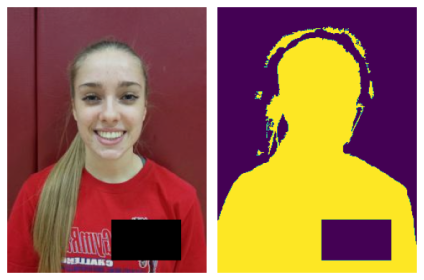

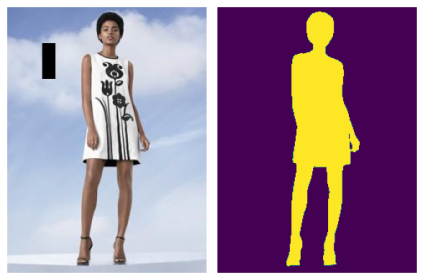

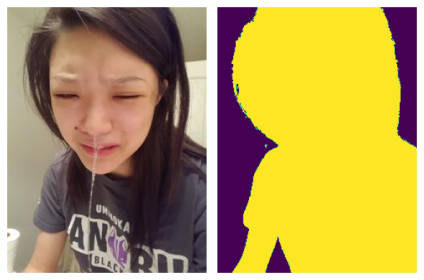

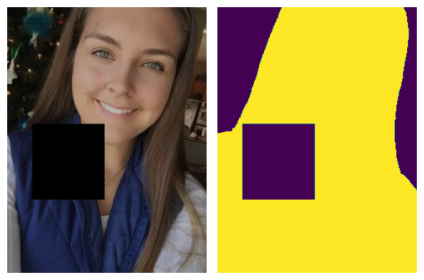

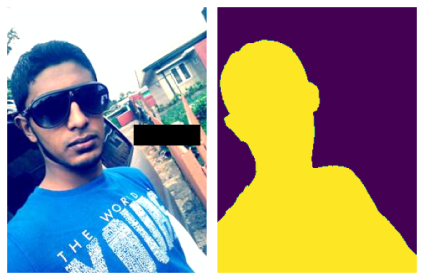

In [ ]:
num_samples_to_show = 5
for idx in range(num_samples_to_show):
    show_idx_image(train_dataset, idx)

## `Загрузчики`

При обучении сети удобнее работать не с датасетами, а с загрузчиками. Загрузчики создаются на основе датасета и позволяют итерироваться по батчам из него.

Обратите внимание на параметры `DataLoader`. При `num_workers`$\;> 1$, батчи готовятся (загружаются картинки, обрабатываются и так далее) сразу в нескольких фоновых процессах. С помощью параметра `shuffle` можно подавать картинки на обучение в случайном порядке.

Обычно, скорость обработки данных на GPU превышает скорость загрузки данных в одном процессе, поэтому типичное значение для `num_workers`$\approx 3\text{-}10$.

Учтите, что на некоторых системах в Jupyter Notebook при `num_workers`$>0$ `DataLoader` перестаёт работать. В таком случае установите это значение в $0$.

In [ ]:
test_data_loader = DataLoader(test_dataset, batch_size=8, num_workers=3)
train_data_loader = DataLoader(train_dataset, batch_size=8, num_workers=3, shuffle=True)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 3 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


## `DiceLoss (1 балл)`

Функция потерь реализовывается как и все стандартные нейронные модули в pytorch, через `torch.nn.Module`. В ячейке ниже вам предлагается реализовать функцию потерь `dice` (аналог меры Жаккарда).

Результат **Dice Loss** определим как:

$$
\text{Dice Coefficient} = 2\frac{|A \cap B| }{|A| + |B|} \leadsto \text{Dice Loss} = 1 - \frac{2\sum\limits_{i, j}a_{ij}b_{ij}}{\sum\limits_{ij}(a_{ij} + b_{ij} + \varepsilon)}
$$

где $a_{ij} \in [0, 1]$ — предсказанная вероятность нахождения человека в пикселе изображения, $b_{ij}$ — истинная разметка для пикселя изображения.

In [ ]:
class DiceLoss(torch.nn.Module):
    def __init__(self, eps=1e-7, reduction=None, with_logits=True):
        """
        Arguments
        ---------
        eps : float
            eps in denominator
        reduction : Optional[str] (None, 'mean' or 'sum')
            specifies the reduction to apply to the output:

            None: no reduction will be applied
            'mean': the sum of the output will be divided by the number of elements in the batch
            'sum':  the output will be summed.
        with_logits : bool
            If True, use additional sigmoid for inputs
        """
        super().__init__()
        self.eps = eps
        self.reduction = reduction
        self.with_logits = with_logits

    def forward(self, logits, true_labels):
        """
        Arguments
        ---------
        logits: torch.Tensor
            Unnormalized probability of true class. Shape: [B, ...]
        true_labels: torch.Tensor
            Mask of correct predictions. Shape: [B, ...]
        Returns
        -------
        torch.Tensor
            If reduction is 'mean' or 'sum' returns a tensor with a single element
            Otherwise, returns a tensor of shape [B]
        """
        true_labels = true_labels.to(torch.long)

        if self.with_logits:
            logits = torch.sigmoid(logits)

        intersection = torch.sum(logits * true_labels, dim=(1, 2))
        union = torch.sum(logits, dim=(1, 2)) + torch.sum(true_labels, dim=(1, 2))
        dice_scores = (2. * intersection + self.eps) / (union + self.eps)

        if self.reduction == 'sum':
            loss_value = torch.sum(1. - dice_scores)
        elif self.reduction == 'mean':
            loss_value = torch.mean(1. - dice_scores)
        elif self.reduction is None:
            loss_value = 1. - dice_scores

        return loss_value

Проверка реализации:

In [ ]:
logits = torch.tensor([
    [[0, 0.5], [0.5, 1]],
    [[0.1, 0.1], [0, 0]],
])

target = torch.tensor([
    [[0, 1], [1, 1]],
    [[1, 0], [0, 1]],
])

losses = DiceLoss(with_logits=False, reduction=None, eps=1e-7)(logits, target)
npt.assert_almost_equal(losses.numpy(), np.array([0.2, 0.90909]), decimal=4)

loss = DiceLoss(with_logits=False, reduction='mean', eps=1e-7)(logits, target)
npt.assert_almost_equal(float(loss.numpy()), 0.554545, decimal=4)

loss = DiceLoss(with_logits=False, reduction='sum', eps=1e-7)(logits, target)
npt.assert_almost_equal(float(loss.numpy()), 1.10909, decimal=4)

## `U-Net (3 балла)`

Для решения задачи сегментации будем использовать [U-Net](https://arxiv.org/pdf/1505.04597.pdf) с энкодером из первых блоков предобученного `VGG13`.

Концептуальная схема представлена на диаграмме ниже:

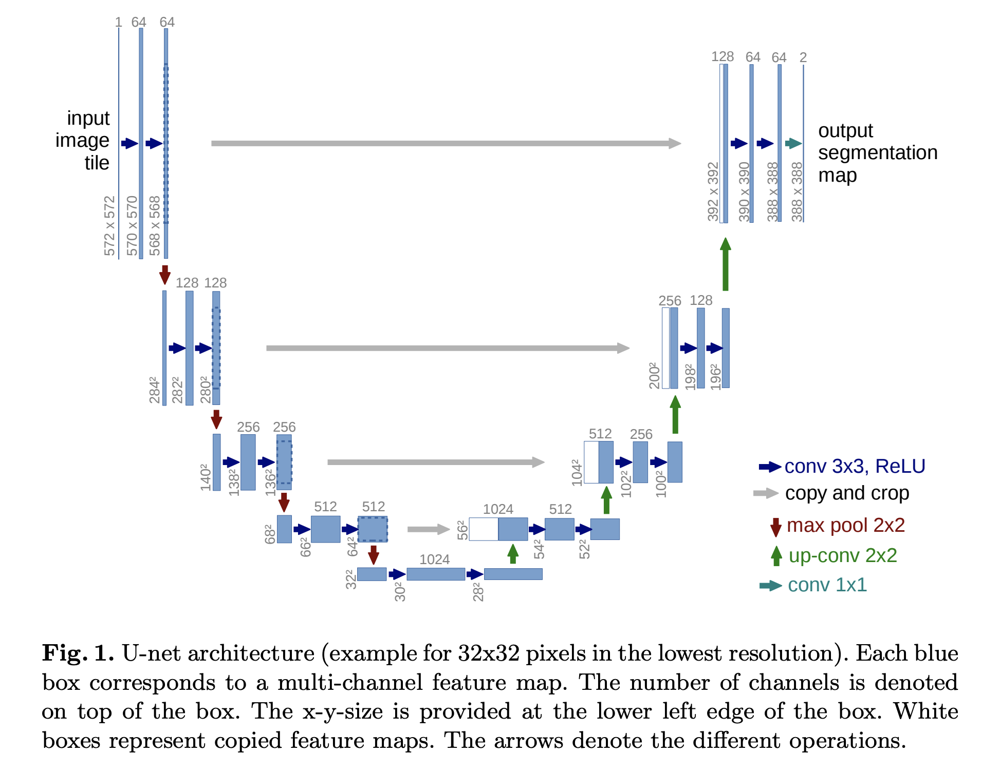

Заметим, что блоки VGG13 имеют следующий вид:
```python
    (0): Conv2d(...)
    (1): ReLU(...)
    (2): Conv2d(...)
    (3): ReLU(...)
    (4): MaxPool2d(...)
```

Для удобства, уберём слои `MaxPool2d` из блоков энкодера и будем применять pooling отдельно.

Реализуйте архитектуру данной сети.

#### `Encoder`

In [ ]:
class VGG13Encoder(torch.nn.Module):
    def __init__(self, num_blocks, weights=VGG13_Weights.DEFAULT):
        super().__init__()
        self.num_blocks = num_blocks

        # Будем использовать предобученную VGG13 в качестве backbone
        feature_extractor = vgg13(weights=weights).features

        # Каждый блок энкодера U-Net — это блок VGG13 без MaxPool2d
        self.blocks = torch.nn.ModuleList()
        for idx in range(self.num_blocks):
            # Возьмите нужные слои из `feature_extractor` для очередного U-Net блока
            # Объедините их с помощью `torch.nn.Sequential`
            block_layers = list(feature_extractor)[idx * 5:idx * 5 + 4]
            block = torch.nn.Sequential(*block_layers)
            self.blocks.append(block)

    def forward(self, x):
        activations = []
        for idx, block in enumerate(self.blocks):
            # Примените очередной блок U-Net
            x = block(x)

            # Сохраните активации для передачи их в декодер
            activations.append(x)

            # При необходимости примените max-pool
            # Можно использовать `torch.functional.F.max_pool2d`
            if idx != len(self.blocks) - 1:
                x = torch.nn.functional.max_pool2d(x, kernel_size=2, stride=2, padding=0, dilation=1)

        return activations

In [ ]:
assert sum((param.numel() for param in VGG13Encoder(num_blocks=1).parameters())) == 38720
assert sum((param.numel() for param in VGG13Encoder(num_blocks=2).parameters())) == 260160
assert sum((param.numel() for param in VGG13Encoder(num_blocks=3).parameters())) == 1145408

x = torch.arange(1 * 3 * 320 * 240).reshape(1, 3, 320, 240) / (1 * 3 * 320 * 240)
out = VGG13Encoder(num_blocks=3)(x)

assert len(out) == 3
npt.assert_almost_equal(torch.linalg.norm(out[0]).item(), 902.218, decimal=3)
npt.assert_almost_equal(torch.linalg.norm(out[1]).item(), 571.030, decimal=3)
npt.assert_almost_equal(torch.linalg.norm(out[2]).item(), 648.068, decimal=3)

Downloading: "https://download.pytorch.org/models/vgg13-19584684.pth" to /root/.cache/torch/hub/checkpoints/vgg13-19584684.pth
100%|██████████| 508M/508M [00:04<00:00, 128MB/s]


#### `Decoder`

In [ ]:
class DecoderBlock(torch.nn.Module):
    def __init__(self, out_channels):
        super().__init__()

        self.upconv = torch.nn.Conv2d(
            in_channels=out_channels * 2, out_channels=out_channels,
            kernel_size=3, padding=1, dilation=1
        )
        self.conv1 = torch.nn.Conv2d(
            in_channels=out_channels * 2, out_channels=out_channels,
            kernel_size=3, padding=1, dilation=1
        )
        self.conv2 = torch.nn.Conv2d(
            in_channels=out_channels, out_channels=out_channels,
            kernel_size=3, padding=1, dilation=1
        )
        self.relu = torch.nn.ReLU()

    def forward(self, down, left):
        # Upsample x2 и свёртка
        x = torch.nn.functional.interpolate(down, scale_factor=2, mode='nearest')
        x = self.upconv(x)

        # Конкатенация выхода энкодера и предыдущего блока декодера
        x = torch.cat([x, left], dim=1)

        # Две свёртки с ReLu
        # your code here
        x = self.conv1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.relu(x)

        return x

In [ ]:
class Decoder(torch.nn.Module):
    def __init__(self, num_filters, num_blocks):
        super().__init__()

        self.blocks = torch.nn.ModuleList()
        for idx in range(num_blocks):
            self.blocks.insert(0, DecoderBlock(num_filters * 2 ** idx))

    def forward(self, acts):
        up = acts[-1]
        for block, left in zip(self.blocks, acts[-2::-1]):
            up = block(up, left)
        return up

#### `U-Net`

In [ ]:
class UNet(torch.nn.Module):
    def __init__(self, num_classes=1, num_blocks=4):
        super().__init__()

        self.num_blocks = num_blocks
        self.encoder = VGG13Encoder(num_blocks=num_blocks)

        self.decoder = Decoder(num_filters=64, num_blocks=num_blocks - 1)

        # Свёртка 1x1 для попиксельной агрегации каналов
        self.final = torch.nn.Conv2d(64, num_classes, kernel_size=1)

    def forward(self, x):
        acts = self.encoder(x)
        x = self.decoder(acts)
        x = self.final(x)

        return x

In [ ]:
model = UNet(num_classes=1, num_blocks=3)
x = torch.arange(1 * 3 * 320 * 240).reshape(1, 3, 320, 240) / (1 * 3 * 320 * 240)

assert sum((param.numel() for param in model.parameters())) == 2067649
assert list(model(x).shape) == [1, 1, 320, 240]
model

UNet(
  (encoder): VGG13Encoder(
    (blocks): ModuleList(
      (0): Sequential(
        (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU(inplace=True)
        (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (3): ReLU(inplace=True)
      )
      (1): Sequential(
        (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU(inplace=True)
        (2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (3): ReLU(inplace=True)
      )
      (2): Sequential(
        (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU(inplace=True)
        (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (3): ReLU(inplace=True)
      )
    )
  )
  (decoder): Decoder(
    (blocks): ModuleList(
      (0): DecoderBlock(
        (upconv): Conv2d(256, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       

### `Оценивание качества сети`


Обычно, оптимизируемый функционал сложно интерпретировать, а так же в разных экспериментах могут использоваться разные функции потерь. Поэтому необходимо замерять и отслеживать независимую метрику качества. Предлагается использовать **IoU (Intersection over Union)** — один из стандартных вариантов для задачи сегментации:
$$
\text{IoU} = \frac{|A \cap B|}{|A \cup B|} = \frac{\sum\limits_{ij}a_{ij}b_{ij}}{\sum\limits_{ij}a_{ij} + b_{ij} - a_{ij}b_{ij}}
$$

In [ ]:
class IoUScore(torch.nn.Module):
    def __init__(self, threshold=0.5, reduction=None, with_logits=False):
        """
        Arguments
        ---------
        threshold : float
            threshold for logits binarization
        reduction : Optional[str] (None, 'mean' or 'sum')
            specifies the reduction to apply to the output:

            None: no reduction will be applied
            'mean': the sum of the output will be divided by the number of elements in the batch
            'sum':  the output will be summed.
        with_logits : bool
            If True, use additional sigmoid for inputs
        """
        super().__init__()

        self.threshold = threshold
        self.reduction = reduction
        self.with_logits = with_logits

    @torch.no_grad()
    def forward(self, logits, true_labels):
        """
        Arguments
        ---------
        logits: torch.Tensor
            Unnormalized probability of true class. Shape: [B, ...]
        true_labels: torch.Tensor
            Mask of correct predictions. Shape: [B, ...]
        Returns
        -------
        torch.Tensor
            If reduction is 'mean' or 'sum' returns a tensor with a single element
            Otherwise, returns a tensor of shape [B]
        """
        if self.with_logits:
            logits = torch.sigmoid(logits)

        pred_masks = torch.where(logits > self.threshold, 1.0, 0.0)
        intersection = torch.sum(pred_masks * true_labels, dim=(-1, -2))
        union = torch.sum(pred_masks + true_labels, dim=(-1, -2)) - intersection

        iou = intersection / union

        if self.reduction == 'sum':
            score = torch.sum(iou)
        elif self.reduction == 'mean':
            score = torch.mean(iou)
        else:
            score = iou

        return score

In [ ]:
logits = torch.tensor([
    [
        [0.3089,  0.4311, -0.9711],
        [0.9030,  1.0325, -0.7607],
        [0.9648, -0.5528, -1.1010]
    ], [
        [0.8906,  0.8099,  0.4458],
        [2.6215, -1.3198,  0.3142],
        [0.2262, -0.9175, -0.0174]
    ], [
        [0.8906,  0.8099,  0.4458],
        [2.6215, -1.3198,  0.3142],
        [0.2262, -0.9175, -0.0174]
    ]
])
true_labels = torch.tensor([
    [
        [0., 1., 0.],
        [1., 0., 0.],
        [0., 0., 1.]
    ], [
        [1., 1., 1.],
        [1., 0., 1.],
        [1., 0., 0.]
    ], [
        [1., 1., 1.],
        [0., 1., 1.],
        [1., 1., 1.]
    ]
])

scores = IoUScore(0.0)(logits, true_labels)
npt.assert_almost_equal(scores.numpy(), np.array([0.3333, 1.0000, 0.5556]), decimal=4)

score = IoUScore(0.0, reduction='sum')(logits, true_labels)
npt.assert_almost_equal(score.item(), 1.8889, decimal=4)

score = IoUScore(0.0, reduction='mean')(logits, true_labels)
npt.assert_almost_equal(score.item(), 0.6296, decimal=4)

### `Tensorboard и логирование`

Для отслеживания процесса обучения обычно требуется сохранять информацию разных его аспектах.

Для полного контроля над процессом обучения обычно требуется сохранять информацию о разных статистиках. Самыми очевидными являются:
1. Значение функции потерь (лосса) на обучающей и тестовой выборках
2. Метики качества, например, **Dice Coefficient** и **IoU (Intersection over Union)** на обучающей и тестовой выборках

Однако, суррогатные метрики могут не отражать реального качества. Поэтому для моделей, которые выдают визуализируемый результат, обычно логируют предсказания для некоторых объектов выборки. В задаче сегментации естественным вариантом является логирование четвёрки: исходное изображение, истинная маска, маска вероятностей истинного класса, бинаризованная маска.

*Замечание:* лосс и качество на обучающей выборке обычно логируют не только в конце каждой эпохи, но и по отдельным батчам на каждой итерации.

3. Чтобы отслеживать динамику обучения необходимо зафиксировать небольшой набор объектов обучающей и тестовой выборок и после каждой эпохи обучения логировать указанные четыре картинки для каждого объекта.

*Замечание:* можно логировать четвёрки изображений независимо, однако, удобнее объединить их на одной [фигуре](https://pytorch.org/docs/stable/tensorboard.html#torch.utils.tensorboard.writer.SummaryWriter.add_figure). Дополнительный плюс — возможность подписать значения метрик для этого объекта в заголовке изображения или добавить colorbar для более простой интерпретации предсказанной маски.

Для удобной категоризации экспериментов обычно в начале обучения сохраняют:

4. [Гиперпараметры модели](https://pytorch.org/docs/stable/tensorboard.html#torch.utils.tensorboard.writer.SummaryWriter.add_hparams)
5. [Структуру модели](https://pytorch.org/docs/stable/tensorboard.html#torch.utils.tensorboard.writer.SummaryWriter.add_graph)

Для исследования технических особенностей обучения полезно логировать следующие статистики:

6. [Распределение весов, активаций, градиентов](https://pytorch.org/docs/stable/tensorboard.html#torch.utils.tensorboard.writer.SummaryWriter.add_histogram). Сохранять гистограммы каждого параметра после каждой итерации может быть вычислительно неэффективно, поэтому обычно сохраняют распределения весов для каждого отдельного слоя нейронной сети после каждой эпохи.
7. Норма весов и норма градиента на каждой итерации

Наконец, после каждой эпохи можно визуализировать промежуточные представления входных данных:

8. Активации после каждого слоя/блока, как изображения
9. Градиенты функции потерь по активациям для некоторых объектов обучающей выборки, как изображения

*Замечание:* для реализации пунктов 8, 9 менять код модели не требуется. Используйте хуки: [register_full_backward_hook](https://pytorch.org/docs/stable/generated/torch.nn.Module.html#torch.nn.Module.register_full_backward_hook) (данный хук не работает с inplace операциями, например, с `torch.nn.ReLU(inplace=True)`. Или не используйте inplace операции, или используйте [`Tensor.register_hook`](https://github.com/pytorch/pytorch/issues/61519)), [register_forward_hook](https://pytorch.org/docs/stable/generated/torch.nn.Module.html#torch.nn.Module.register_forward_hook).

При реализации цикла обучения необходимо сохранять метрики $1\text{-}9$ с использованием модуля [torch.utils.tensorboard](https://pytorch.org/docs/stable/tensorboard.html). Файлы с логами, а также чекпоинты весов модели после итерации с наилучшим валидационным качеством (смотрите [torch.save](https://pytorch.org/docs/stable/generated/torch.save.html) и [torch.nn.Module.state_dict](https://pytorch.org/tutorials/recipes/recipes/what_is_state_dict.html)) для **ВСЕХ** проведённых экспериментов (за исключением упавших, недосчитанных и так далее) необходимо сдать в anytask.

### `Эксперименты`

Теперь применим сеть на практике!

Обучите сеть на обучающей выборке и протестируйте качество на тестовой выборке.

Сначала при обучении используйте только кросс-энтропию (`torch.nn.BCEWithLogitsLoss` будет более удобна для бинарного случая). Зафиксируйте результат.

Сравните между собой несколько стратегий оптимизации:
1. Только кросс-энтропия
2. Только dice loss
3. Сумма двух лоссов с весами (попробуйте $3\text{-} 4$ разных соотношения)

**Для всех экспериментов отобразите графики функции потерь и качества за время обучения. Выведите получившиеся маски для нескольких изображений из датасета. Сделайте выводы.**

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir .

<IPython.core.display.Javascript object>

In [ ]:
iou_metric = IoUScore(with_logits=True, reduction='mean')
bce_loss = torch.nn.BCEWithLogitsLoss()
dice_loss = DiceLoss(reduction='mean')

In [ ]:
from torchvision.utils import make_grid
from torch.utils.tensorboard import SummaryWriter

def visualize_results(images, masks, outputs, epoch, writer, prefix='Train', metrics=None, mode='logging'):
    fig, axes = plt.subplots(len(images), 4, figsize=(9, 3 * len(images)))

    for i in range(len(images)):
        image = (images[i].cpu().permute(1, 2, 0) * np.array([0.229, 0.224, 0.225])) + np.array([0.485, 0.456, 0.406])
        axes[i, 0].imshow(image)
        axes[i, 0].set_title('Original image')
        axes[i, 0].axis('off')

        axes[i, 1].imshow(masks[i].cpu().squeeze(), cmap='gray')
        axes[i, 1].set_title('True mask')
        axes[i, 1].axis('off')

        axes[i, 2].imshow(outputs[i].detach().cpu().squeeze(), cmap='jet')
        axes[i, 2].set_title('Pred. mask')
        axes[i, 2].axis('off')

        axes[i, 3].imshow((outputs[i].detach().cpu().squeeze() > 0).cpu().numpy(), cmap='gray')
        axes[i, 3].set_title(f'Binary pred. mask\nDice: {metrics["dice"][i]:.4f} | IoU: {metrics["iou"][i]:.4f}')
        axes[i, 3].axis('off')

        plt.tight_layout()
    if mode == 'logging':
        writer.add_figure(f"Images' masks/{prefix}", fig, global_step=epoch)
    else:
        plt.show()

In [ ]:
def visualize_activations_and_gradients(model, images, writer, step):
    activations = {}
    gradients = {}

    def hooks_activations(module, input, output):
        activations[module] = output.detach().cpu()

    def hooks_gradients(module, grad_input, grad_output):
        gradients[module] = grad_output.detach().cpu()

    hooks = []

    for name, module in model.named_modules():
        if isinstance(module, torch.nn.ReLU):
            hook_activation = module.register_forward_hook(hooks_activations)
            hook_gradient = module.register_backward_hook(hooks_gradients)
            hooks.extend([hook_activation, hook_gradient])

    model.eval()
    with torch.no_grad():
        outputs = model(images)

    for hook in hooks:
        hook.remove()

    for name, activation in activations.items():
        writer.add_images(f'Activations/{name}', activation[:, 1, :, :][:, None, :, :], global_step=step)

    for name, gradient in gradients.items():
        writer.add_images(f'Gradients/{name}', gradient[:, 1, :, :][:, None, :, :], global_step=step)

In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda', index=0)

In [ ]:
def grath_building(losses, dice_scores, iou_scores, mode='Train'):
    plt.figure(figsize=(10, 5))
    plt.plot(range(1, len(losses) + 1), losses, label=f'{mode} Loss')
    plt.plot(range(1, len(losses) + 1), dice_scores, label=f'{mode} dice_score')
    plt.plot(range(1, len(losses) + 1), iou_scores, label=f'{mode} iou_score')
    plt.ylabel('Metrics')
    plt.xlabel('Epoch' if mode == 'Test' else 'Batch')
    plt.legend()
    plt.title('Train metrics' if mode == 'Train' else 'Test metrics')
    plt.grid()
    plt.show()

In [ ]:
@torch.no_grad()
def evaluate_model(model, loss_function, epoch, writer, test_loader):
    model.eval()
    with torch.no_grad():
        total_loss = 0.0
        total_dice = 0.0
        total_iou = 0.0

        for batch_idx, (images, masks) in enumerate(test_loader):
            images, masks = images.to(device), (masks.type('torch.cuda.FloatTensor') / 255).to(device)
            outputs = model(images)

            batch_loss = loss_function(outputs, masks).item()
            batch_dice = dice_loss(outputs, masks).item()
            batch_iou = iou_metric(outputs, masks).item()

            total_loss += batch_loss
            total_dice += batch_dice
            total_iou += batch_iou

            if batch_idx == 0:
                sample_images = images[:5]
                sample_masks = masks[:5]
                sample_outputs = model(sample_images).to(device)
                dice_losses = [dice_loss(sample_outputs[i], sample_masks[i]).item() for i in range(5)]
                iou_metrics = [iou_metric(sample_outputs[i], sample_masks[i]).item() for i in range(5)]
                metrics = {"dice": dice_losses, "iou": iou_metrics}
                visualize_results(sample_images, sample_masks, sample_outputs, epoch, writer, prefix='Test', metrics=metrics)

    return total_loss / len(test_loader), total_dice / len(test_loader), total_iou / len(test_loader)

In [ ]:
import torchvision.utils as vutils
import time

def train_model(model, optimizer, loss_function, model_name, train_loader, writer, num_epochs=10):
    start_time = time.time()

    model.train()
    sample_images = None
    best_val_loss = float('inf')
    best_epoch = 0

    train_losses = []
    train_dice_scores = []
    train_iou_scores = []

    test_losses = []
    test_dice_scores = []
    test_iou_scores = []

    for epoch in range(num_epochs):
        epoch_time = time.time()
        epoch_loss = 0.0
        epoch_dice = 0.0
        epoch_iou = 0.0

        for batch_idx, (images, masks) in enumerate(train_loader):
            optimizer.zero_grad()
            images, masks = images.to(device), (masks.type('torch.FloatTensor') / 255).to(device)

            if sample_images is None:
                sample_images = images[:5]
                sample_masks = masks[:5]

            outputs = model(images)
            loss = loss_function(outputs, masks)
            loss.backward()
            optimizer.step()

            with torch.no_grad():
                epoch_loss += loss.item()
                dice = dice_loss(outputs, masks)
                iou = iou_metric(outputs, masks)

                epoch_dice += dice.item()
                epoch_iou += iou.item()

                writer.add_scalar('Loss/train by batch', loss.item(), epoch * len(train_loader) + batch_idx)
                writer.add_scalar('Dice/train by batch', dice.item(), epoch * len(train_loader) + batch_idx)
                writer.add_scalar('IoU/train by batch', iou.item(), epoch * len(train_loader) + batch_idx)

                train_losses.append(loss.item())
                train_dice_scores.append(dice.item())
                train_iou_scores.append(iou.item())

        visualize_activations_and_gradients(model, sample_images, writer, epoch)

        with torch.no_grad():
            # Считаем метрики для каждой из картинок, на которых отслеживаем прогресс. Затем отрисовываем их в тензорборд
            sample_outputs = model(sample_images).to(device)
            dice_losses = [dice_loss(sample_outputs[i], sample_masks[i]).item() for i in range(5)]
            iou_metrics = [iou_metric(sample_outputs[i], sample_masks[i]).item() for i in range(5)]
            metrics = {"dice": dice_losses, "iou": iou_metrics}
            visualize_results(sample_images, sample_masks, sample_outputs, epoch, writer, prefix='Train', metrics=metrics)

            for name, param in model.named_parameters():
                writer.add_histogram(f'Weights Histogram/{name}', param, epoch)
                writer.add_histogram(f'Gradients Histogram/{name}', param.grad, epoch)
                writer.add_scalar(f'Weight Norm/{name}', param.norm().item(), epoch)
                writer.add_scalar(f'Gradient Norm/{name}', param.grad.norm().item(), epoch)

            epoch_loss /= len(train_loader)
            epoch_dice /= len(train_loader)
            epoch_iou /= len(train_loader)

            val_loss, val_dice, val_iou = evaluate_model(model, loss_function, epoch, writer, train_loader)

            test_losses.append(val_loss)
            test_dice_scores.append(val_dice)
            test_iou_scores.append(val_iou)

            if val_loss < best_val_loss:
                best_val_loss = val_loss
                best_epoch = epoch
                torch.save(model.state_dict(), f'{model_name}_best_model.pth')

            writer.add_scalar('Loss/train by epoch', epoch_loss, epoch)
            writer.add_scalar('Dice/train by epoch', epoch_dice, epoch)
            writer.add_scalar('IoU/train by epoch', epoch_iou, epoch)

            writer.add_scalar('Loss/test by epoch', val_loss, epoch)
            writer.add_scalar('Dice/test by epoch', val_dice, epoch)
            writer.add_scalar('IoU/test by epoch', val_iou, epoch)

            print(f'Epoch {epoch + 1}/{num_epochs}, Loss: {epoch_loss:.4f}, Dice: {epoch_dice:.4f}, IoU: {epoch_iou:.4f}, time: {time.time() - epoch_time:.1f} s.')

            best_model_path = f'{model_name}_best_model.pth'
    if os.path.exists(best_model_path):
        model.load_state_dict(torch.load(best_model_path))
        print(f'Best model loaded from checkpoint: {best_model_path}')
    else:
        print(f'Best model checkpoint not found at: {best_model_path}')

    print(f'Best model achieved at Epoch {best_epoch + 1} with Val Loss: {best_val_loss:.4f}. Total time: {time.time() - start_time:.1f} s.')

    grath_building(train_losses, train_dice_scores, train_iou_scores)
    grath_building(test_losses, test_dice_scores, test_iou_scores, mode='Test')
    visualize_results(sample_images[:3], sample_masks[:3], sample_outputs[:3], epoch, writer, prefix='Train', metrics=metrics, mode='print')

In [ ]:
@torch.no_grad()
def test_model(model, test_loader, writer):
    model.eval()
    with torch.no_grad():
        total_dice = 0.0
        total_iou = 0.0

        for batch_idx, (images, masks) in enumerate(test_loader):
            images, masks = images.to(device), (masks.type('torch.FloatTensor') / 255).to(device)
            outputs = model(images)

            dice = dice_loss(outputs, masks)
            iou = iou_metric(outputs, masks)

            total_dice += dice.item()
            total_iou += iou.item()

            if batch_idx == 3:
                out = model(images[:5]).to(device)
                dice_losses = [dice_loss(out[i], masks[i]).item() for i in range(5)]
                iou_metrics = [iou_metric(out[i], masks[i]).item() for i in range(5)]
                metrics = {"dice": dice_losses, "iou": iou_metrics}
                visualize_results(images[:5], masks[:5], out, 1, writer, prefix='Test', metrics=metrics)
                print('Test images:')
                visualize_results(images[:3], masks[:3], out, 1, writer, prefix='Test', metrics=metrics, mode='print')

        avg_dice = total_dice / len(test_loader)
        avg_iou = total_iou / len(test_loader)



        print(f'Test Dice: {avg_dice:.4f}, Test IoU: {avg_iou:.4f}')

функция потерь -- **Binary Cross Entropy**

In [ ]:
model_name = 'UNet_BCE'
torch.cuda.empty_cache()
writer = SummaryWriter(f'runs/{model_name}_{time.ctime()}')
hparams = {
    'model_name': 'UNet',
    'num_classes': 1,
    'num_blocks': 3,
    'num_epochs': 20,
    'lr': 1e-3,
    'loss_function': 'BCEWithLogitsLoss'
}
writer.add_hparams(hparams, {})

model = UNet(num_classes=hparams['num_classes'], num_blocks=hparams['num_blocks']).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=hparams['lr'])

inputs = torch.randn(1, 3, 224, 224).to(device)
writer.add_graph(model, inputs)

Epoch 1/20, Loss: 0.7744, Dice: 0.4180, IoU: 0.5968, time: 9.4 s.


Epoch 2/20, Loss: 0.6400, Dice: 0.4701, IoU: 0.6295, time: 9.5 s.


Epoch 3/20, Loss: 0.6014, Dice: 0.4383, IoU: 0.5728, time: 8.3 s.


Epoch 4/20, Loss: 0.5207, Dice: 0.3532, IoU: 0.7158, time: 9.0 s.


Epoch 5/20, Loss: 0.4542, Dice: 0.3056, IoU: 0.7499, time: 8.9 s.


Epoch 6/20, Loss: 0.4056, Dice: 0.2987, IoU: 0.7496, time: 9.4 s.


Epoch 7/20, Loss: 0.3870, Dice: 0.2647, IoU: 0.7696, time: 8.1 s.


Epoch 8/20, Loss: 0.3861, Dice: 0.2769, IoU: 0.7532, time: 8.9 s.


Epoch 9/20, Loss: 0.3643, Dice: 0.3072, IoU: 0.7661, time: 9.6 s.


Epoch 10/20, Loss: 0.2975, Dice: 0.2306, IoU: 0.8075, time: 8.4 s.


Epoch 11/20, Loss: 0.3192, Dice: 0.2186, IoU: 0.8054, time: 8.5 s.


Epoch 12/20, Loss: 0.2979, Dice: 0.2526, IoU: 0.8206, time: 9.1 s.


Epoch 13/20, Loss: 0.2710, Dice: 0.2292, IoU: 0.8323, time: 9.5 s.


Epoch 14/20, Loss: 0.3027, Dice: 0.1889, IoU: 0.8433, time: 8.3 s.


Epoch 15/20, Loss: 0.2763, Dice: 0.2323, IoU: 0.8190, time: 8.7 s.


Epoch 16/20, Loss: 0.2841, Dice: 0.2285, IoU: 0.8291, time: 8.9 s.


Epoch 17/20, Loss: 0.2168, Dice: 0.1906, IoU: 0.8669, time: 8.8 s.


Epoch 18/20, Loss: 0.2384, Dice: 0.1851, IoU: 0.8479, time: 9.8 s.


Epoch 19/20, Loss: 0.1922, Dice: 0.1750, IoU: 0.8826, time: 8.6 s.


Epoch 20/20, Loss: 0.1873, Dice: 0.1715, IoU: 0.8878, time: 9.0 s.
Best model loaded from checkpoint: UNet_BCE_best_model.pth
Best model achieved at Epoch 20 with Val Loss: 0.1749. Total time: 178.6 s.


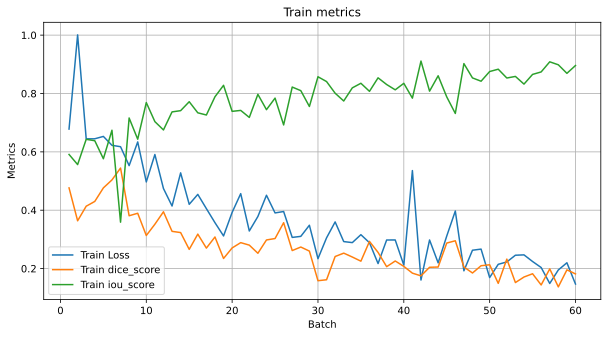

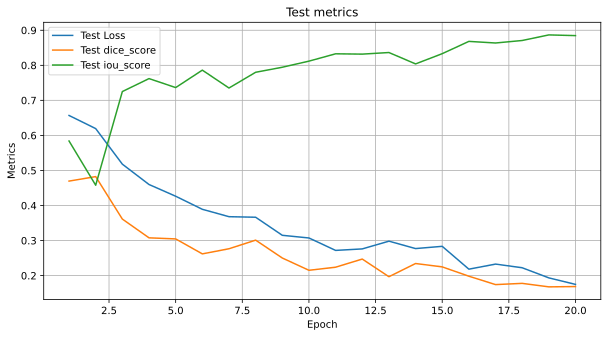

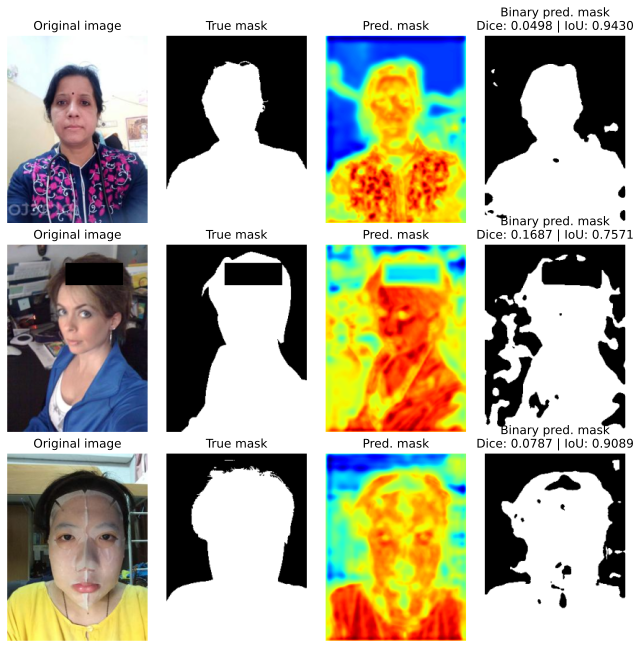

In [ ]:
train_model(model, optimizer, loss_function=bce_loss, model_name=model_name, train_loader=train_data_loader, writer=writer, num_epochs=hparams['num_epochs'])
writer.close()

Функция потерь -- **Dice Loss**

In [ ]:
model_name = 'UNet_DiceLoss'
writer = SummaryWriter(f'runs/{model_name}_{time.ctime()}')
hparams = {
    'model_name': 'UNet',
    'num_classes': 1,
    'num_blocks': 3,
    'num_epochs': 20,
    'lr': 1e-3,
    'loss_function': 'DiceLoss'
}
writer.add_hparams(hparams, {})
model = UNet(num_classes=hparams['num_classes'], num_blocks=hparams['num_blocks']).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=hparams['lr'])

# Создание экземпляра модели для добавления графа в SummaryWriter
inputs = torch.randn(1, 3, 224, 224).to(device)  # Пример входных данных для модели
writer.add_graph(model, inputs)

Epoch 1/20, Loss: 0.3823, Dice: 0.3823, IoU: 0.5735, time: 9.0 s.


Epoch 2/20, Loss: 0.3138, Dice: 0.3138, IoU: 0.5849, time: 10.1 s.


Epoch 3/20, Loss: 0.3115, Dice: 0.3115, IoU: 0.5874, time: 9.2 s.


Epoch 4/20, Loss: 0.3064, Dice: 0.3064, IoU: 0.5935, time: 12.1 s.


Epoch 5/20, Loss: 0.3131, Dice: 0.3131, IoU: 0.5853, time: 9.2 s.


Epoch 6/20, Loss: 0.3050, Dice: 0.3050, IoU: 0.5942, time: 9.3 s.


Epoch 7/20, Loss: 0.3107, Dice: 0.3107, IoU: 0.5868, time: 8.9 s.


Epoch 8/20, Loss: 0.3177, Dice: 0.3177, IoU: 0.5781, time: 9.3 s.


Epoch 9/20, Loss: 0.3098, Dice: 0.3098, IoU: 0.5911, time: 10.0 s.


Epoch 10/20, Loss: 0.3106, Dice: 0.3106, IoU: 0.5877, time: 8.5 s.


Epoch 11/20, Loss: 0.3180, Dice: 0.3180, IoU: 0.5782, time: 9.0 s.


Epoch 12/20, Loss: 0.3132, Dice: 0.3132, IoU: 0.5882, time: 9.1 s.


Epoch 13/20, Loss: 0.3138, Dice: 0.3138, IoU: 0.5825, time: 10.2 s.


Epoch 14/20, Loss: 0.3198, Dice: 0.3198, IoU: 0.5739, time: 8.5 s.


Epoch 15/20, Loss: 0.3162, Dice: 0.3162, IoU: 0.5817, time: 8.8 s.


Epoch 16/20, Loss: 0.3117, Dice: 0.3117, IoU: 0.5843, time: 9.3 s.


Epoch 17/20, Loss: 0.3063, Dice: 0.3063, IoU: 0.5921, time: 10.2 s.


Epoch 18/20, Loss: 0.3166, Dice: 0.3166, IoU: 0.5784, time: 8.5 s.


Epoch 19/20, Loss: 0.3157, Dice: 0.3157, IoU: 0.5834, time: 9.9 s.


Epoch 20/20, Loss: 0.3123, Dice: 0.3123, IoU: 0.5861, time: 9.2 s.
Best model loaded from checkpoint: UNet_DiceLoss_best_model.pth
Best model achieved at Epoch 4 with Val Loss: 0.3029. Total time: 188.1 s.


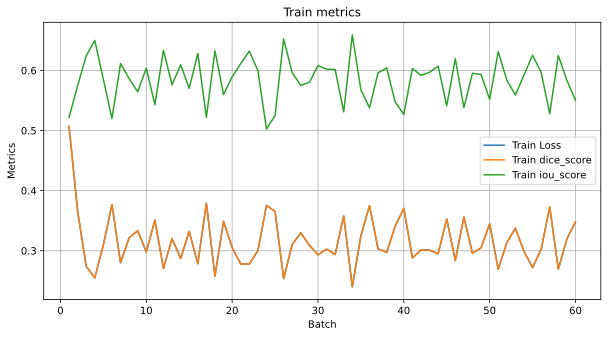

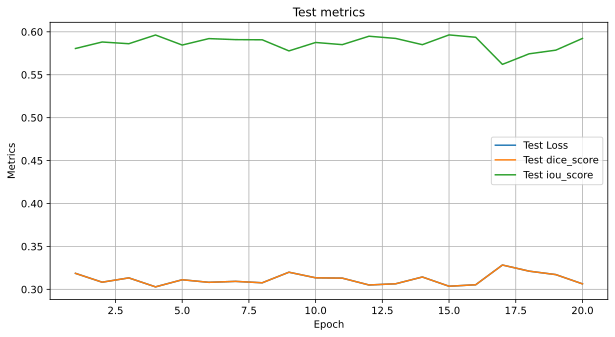

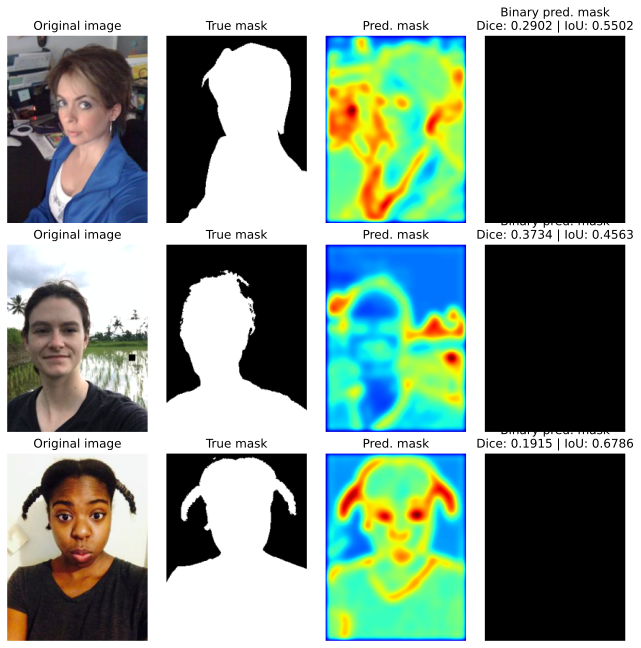

In [ ]:
train_model(model, optimizer, loss_function=DiceLoss(reduction='mean'), model_name=model_name, train_loader=train_data_loader, writer=writer, num_epochs=hparams['num_epochs'])
writer.close()

Функция потерь -- среднее из **Binary Cross Entropy** и **Dice Loss**

In [ ]:
dice = DiceLoss(reduction='mean')

def dice_and_bce_loss(outputs, masks):
    global weights, dice
    total_loss = weights[0] * bce_loss(outputs, masks) + weights[1] * dice(outputs, masks)
    return total_loss

In [ ]:
model_name = 'Unet_0.5_BCE_0.5_Dice'
torch.cuda.empty_cache()
writer = SummaryWriter(f'runs/{model_name}_{time.ctime()}')
hparams = {
    'model_name': 'UNet',
    'num_classes': 1,
    'num_blocks': 3,
    'num_epochs': 20,
    'lr': 1e-3,
    'loss_function': '0.5 BCE Loss + 0.5 Dice Loss'
}
writer.add_hparams(hparams, {})

model = UNet(num_classes=hparams['num_classes'], num_blocks=hparams['num_blocks']).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=hparams['lr'])

inputs = torch.randn(1, 3, 224, 224).to(device)
writer.add_graph(model, inputs)

weights = (0.5, 0.5)

Epoch 1/20, Loss: 0.5909, Dice: 0.4308, IoU: 0.5817, time: 8.9 s.


Epoch 2/20, Loss: 0.5511, Dice: 0.4538, IoU: 0.5956, time: 11.4 s.


Epoch 3/20, Loss: 0.4830, Dice: 0.3753, IoU: 0.6877, time: 9.3 s.


Epoch 4/20, Loss: 0.5448, Dice: 0.3691, IoU: 0.6420, time: 9.5 s.


Epoch 5/20, Loss: 0.5110, Dice: 0.2969, IoU: 0.6800, time: 8.5 s.


Epoch 6/20, Loss: 0.4409, Dice: 0.3423, IoU: 0.7083, time: 9.3 s.


Epoch 7/20, Loss: 0.4442, Dice: 0.3678, IoU: 0.7035, time: 9.3 s.


Epoch 8/20, Loss: 0.4030, Dice: 0.3380, IoU: 0.7089, time: 9.0 s.


Epoch 9/20, Loss: 0.3463, Dice: 0.2802, IoU: 0.7412, time: 9.1 s.


Epoch 10/20, Loss: 0.3377, Dice: 0.2624, IoU: 0.7523, time: 8.8 s.


Epoch 11/20, Loss: 0.3141, Dice: 0.2297, IoU: 0.7725, time: 9.1 s.


Epoch 12/20, Loss: 0.3742, Dice: 0.2455, IoU: 0.7439, time: 9.7 s.


Epoch 13/20, Loss: 0.3772, Dice: 0.2665, IoU: 0.7394, time: 8.4 s.


Epoch 14/20, Loss: 0.3448, Dice: 0.2883, IoU: 0.7645, time: 8.6 s.


Epoch 15/20, Loss: 0.2844, Dice: 0.2345, IoU: 0.7952, time: 9.1 s.


Epoch 16/20, Loss: 0.2937, Dice: 0.2288, IoU: 0.7961, time: 10.1 s.


Epoch 17/20, Loss: 0.2538, Dice: 0.2182, IoU: 0.8191, time: 8.5 s.


Epoch 18/20, Loss: 0.2470, Dice: 0.2044, IoU: 0.8319, time: 8.5 s.


Epoch 19/20, Loss: 0.2219, Dice: 0.1946, IoU: 0.8388, time: 9.1 s.


Epoch 20/20, Loss: 0.2618, Dice: 0.1751, IoU: 0.8353, time: 8.9 s.
Best model loaded from checkpoint: Unet_0.5_BCE_0.5_Dice_best_model.pth
Best model achieved at Epoch 18 with Val Loss: 0.2330. Total time: 183.3 s.


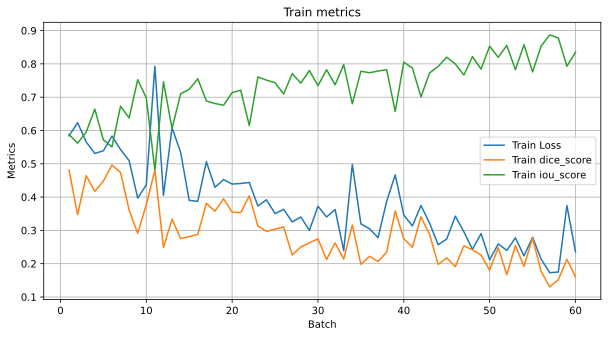

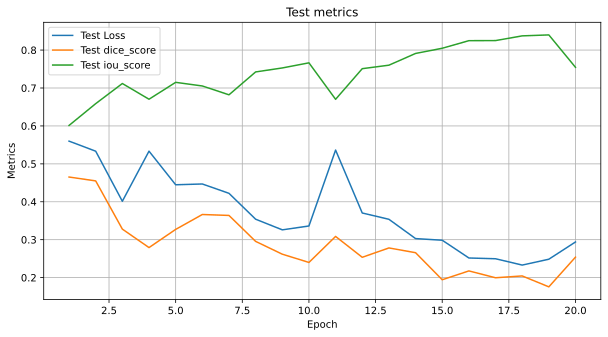

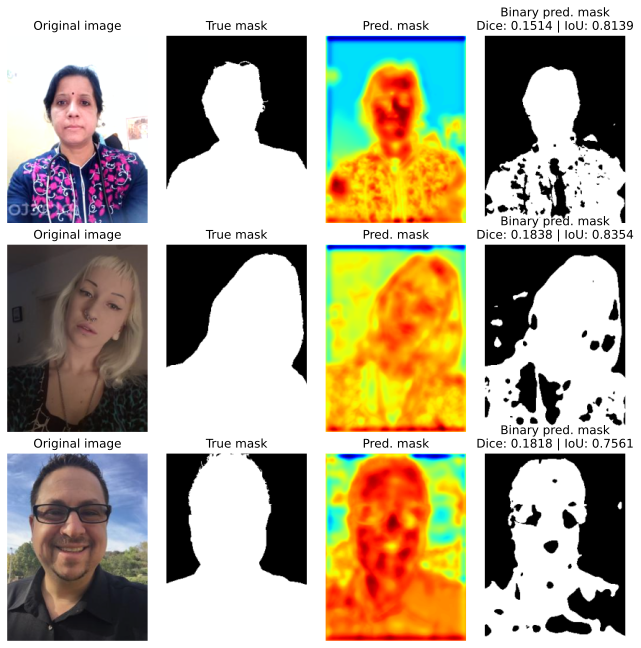

In [ ]:
train_model(model, optimizer, loss_function=dice_and_bce_loss, model_name=model_name, train_loader=train_data_loader, writer=writer, num_epochs=hparams['num_epochs'])
writer.close()

Функция потерь -- 80% **Binary Cross Entropy** и 20% **Dice Loss**

In [ ]:
model_name = 'Unet_0.8_BCE_0.2_Dice'
torch.cuda.empty_cache()
writer = SummaryWriter(f'runs/{model_name}_{time.ctime()}')
hparams = {
    'model_name': 'UNet',
    'num_classes': 1,
    'num_blocks': 3,
    'num_epochs': 20,
    'lr': 1e-3,
    'loss_function': '0.8 BCE Loss + 0.2 Dice Loss'
}
writer.add_hparams(hparams, {})

model = UNet(num_classes=hparams['num_classes'], num_blocks=hparams['num_blocks']).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=hparams['lr'])

inputs = torch.randn(1, 3, 224, 224).to(device)
writer.add_graph(model, inputs)

weights = (0.8, 0.2)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 3 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Epoch 1/20, Loss: 1.1466, Dice: 0.4165, IoU: 0.4149, time: 11.8 s.


Epoch 2/20, Loss: 0.6035, Dice: 0.4752, IoU: 0.5634, time: 9.1 s.


Epoch 3/20, Loss: 0.5847, Dice: 0.4595, IoU: 0.6983, time: 10.0 s.


Epoch 4/20, Loss: 0.5469, Dice: 0.4090, IoU: 0.6941, time: 9.3 s.


Epoch 5/20, Loss: 0.4659, Dice: 0.3353, IoU: 0.7094, time: 9.8 s.


Epoch 6/20, Loss: 0.4291, Dice: 0.3031, IoU: 0.7189, time: 8.5 s.


Epoch 7/20, Loss: 0.3786, Dice: 0.2862, IoU: 0.7570, time: 9.8 s.


Epoch 8/20, Loss: 0.3993, Dice: 0.2784, IoU: 0.7497, time: 9.7 s.


Epoch 9/20, Loss: 0.4389, Dice: 0.3225, IoU: 0.7147, time: 9.3 s.


Epoch 10/20, Loss: 0.3896, Dice: 0.2695, IoU: 0.7676, time: 8.7 s.


Epoch 11/20, Loss: 0.3593, Dice: 0.2827, IoU: 0.7482, time: 9.8 s.


Epoch 12/20, Loss: 0.3412, Dice: 0.2610, IoU: 0.7622, time: 9.0 s.


Epoch 13/20, Loss: 0.3197, Dice: 0.2629, IoU: 0.7986, time: 9.2 s.


Epoch 14/20, Loss: 0.2989, Dice: 0.2490, IoU: 0.8083, time: 9.2 s.


Epoch 15/20, Loss: 0.2633, Dice: 0.2097, IoU: 0.8398, time: 9.7 s.


Epoch 16/20, Loss: 0.3220, Dice: 0.2250, IoU: 0.7978, time: 8.8 s.


Epoch 17/20, Loss: 0.2791, Dice: 0.2400, IoU: 0.8142, time: 9.1 s.


Epoch 18/20, Loss: 0.2731, Dice: 0.2446, IoU: 0.8071, time: 9.0 s.


Epoch 19/20, Loss: 0.2569, Dice: 0.2032, IoU: 0.8355, time: 8.7 s.


Epoch 20/20, Loss: 0.2389, Dice: 0.1868, IoU: 0.8449, time: 9.9 s.
Best model loaded from checkpoint: Unet_0.8_BCE_0.2_Dice_best_model.pth
Best model achieved at Epoch 20 with Val Loss: 0.2235. Total time: 188.2 s.


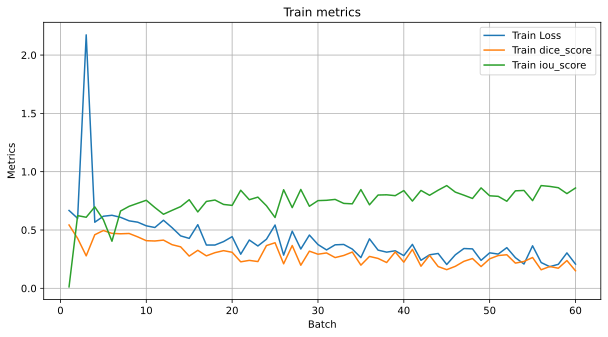

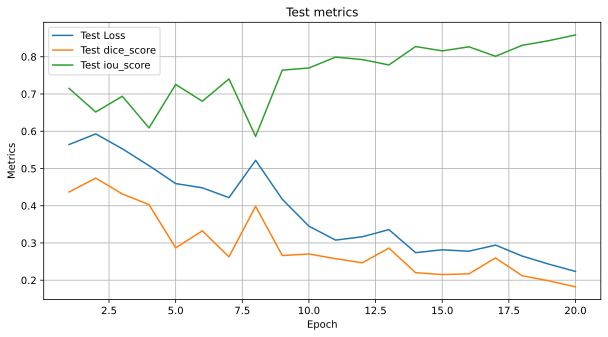

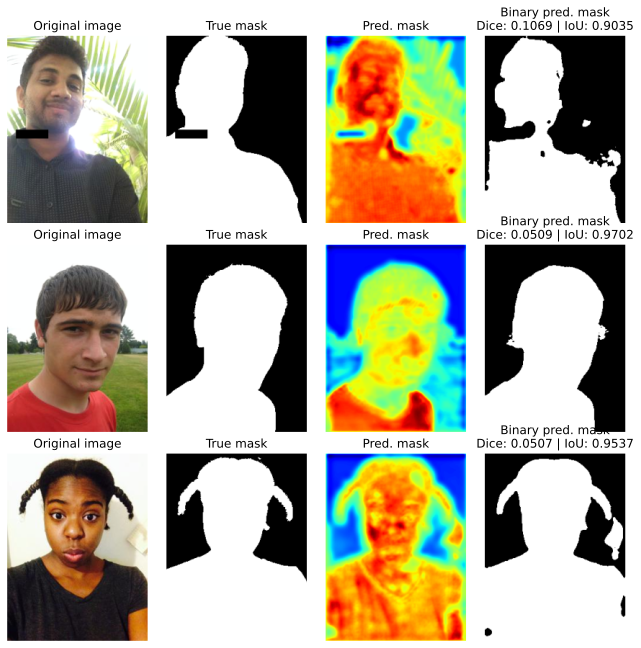

In [ ]:
train_model(model, optimizer, loss_function=dice_and_bce_loss, model_name=model_name, train_loader=train_data_loader, writer=writer, num_epochs=hparams['num_epochs'])
writer.close()

Функция потерь -- 20% **Binary Cross Entropy** и 80% **Dice Loss**

In [ ]:
model_name = 'Unet_0.2_BCE_0.8_Dice'
torch.cuda.empty_cache()
writer = SummaryWriter(f'runs/{model_name}_{time.ctime()}')
hparams = {
    'model_name': 'UNet',
    'num_classes': 1,
    'num_blocks': 3,
    'num_epochs': 20,
    'lr': 1e-3,
    'loss_function': '0.2 BCE Loss + 0.8 Dice Loss'
}
writer.add_hparams(hparams, {})

model = UNet(num_classes=hparams['num_classes'], num_blocks=hparams['num_blocks']).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=hparams['lr'])

inputs = torch.randn(1, 3, 224, 224).to(device)
writer.add_graph(model, inputs)

weights = (0.2, 0.8)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 3 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Epoch 1/20, Loss: 0.8287, Dice: 0.3954, IoU: 0.5815, time: 9.7 s.


Epoch 2/20, Loss: 0.4455, Dice: 0.4008, IoU: 0.5975, time: 9.2 s.


Epoch 3/20, Loss: 0.4333, Dice: 0.3893, IoU: 0.5934, time: 9.0 s.


Epoch 4/20, Loss: 0.3985, Dice: 0.3454, IoU: 0.6487, time: 8.4 s.


Epoch 5/20, Loss: 0.3640, Dice: 0.2979, IoU: 0.6916, time: 8.7 s.


Epoch 6/20, Loss: 0.3316, Dice: 0.2561, IoU: 0.7325, time: 12.2 s.


Epoch 7/20, Loss: 0.3295, Dice: 0.2565, IoU: 0.7263, time: 9.2 s.


Epoch 8/20, Loss: 0.2747, Dice: 0.2313, IoU: 0.7712, time: 9.3 s.


Epoch 9/20, Loss: 0.2725, Dice: 0.2343, IoU: 0.7695, time: 9.7 s.


Epoch 10/20, Loss: 0.2752, Dice: 0.2245, IoU: 0.7729, time: 8.7 s.


Epoch 11/20, Loss: 0.2246, Dice: 0.1933, IoU: 0.8170, time: 9.3 s.


Epoch 12/20, Loss: 0.2393, Dice: 0.1935, IoU: 0.8006, time: 9.3 s.


Epoch 13/20, Loss: 0.2213, Dice: 0.1955, IoU: 0.8213, time: 10.2 s.


Epoch 14/20, Loss: 0.2120, Dice: 0.1893, IoU: 0.8308, time: 8.7 s.


Epoch 15/20, Loss: 0.1906, Dice: 0.1658, IoU: 0.8471, time: 8.8 s.


Epoch 16/20, Loss: 0.2008, Dice: 0.1619, IoU: 0.8373, time: 9.2 s.


Epoch 17/20, Loss: 0.1861, Dice: 0.1657, IoU: 0.8506, time: 9.2 s.


Epoch 18/20, Loss: 0.1820, Dice: 0.1610, IoU: 0.8536, time: 9.8 s.


Epoch 19/20, Loss: 0.1817, Dice: 0.1529, IoU: 0.8573, time: 8.7 s.


Epoch 20/20, Loss: 0.2230, Dice: 0.1646, IoU: 0.8277, time: 9.4 s.
Best model loaded from checkpoint: Unet_0.2_BCE_0.8_Dice_best_model.pth
Best model achieved at Epoch 18 with Val Loss: 0.1642. Total time: 186.7 s.


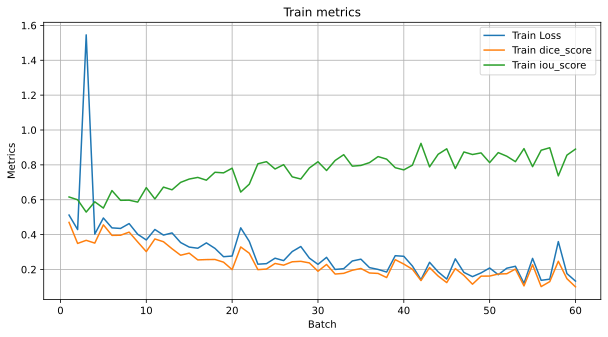

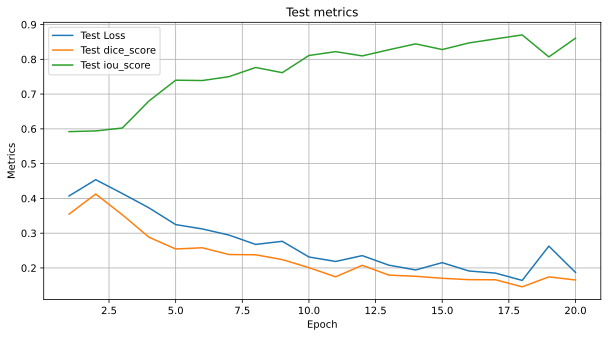

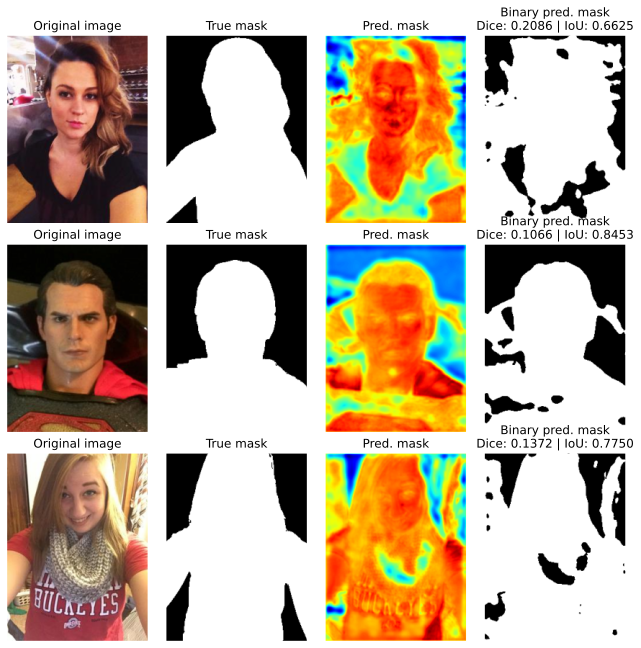

In [ ]:
train_model(model, optimizer, loss_function=dice_and_bce_loss, model_name=model_name, train_loader=train_data_loader, writer=writer, num_epochs=hparams['num_epochs'])
writer.close()

## `LinkNet (2 балла)`

Реализуйте архитектуру [LinkNet](https://arxiv.org/pdf/1707.03718.pdf) с использованием энкодера, основанного на `VGG13`. Архитектура похожа на `Unet`, но вместо конкатенации слоёв используются skip-connections. Для реализации достаточно переписать структуру декодировщика из предыдущего пункта.

**Обучите сеть и проведите анализ согласно предыдущему пункту. Сравните LinkNet и U-Net по качеству и скорости работы. Сделайте выводы.**

In [ ]:
class LinkNetDecoderBlock(torch.nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.upconv = torch.nn.ConvTranspose2d(
            in_channels, out_channels, kernel_size=2, stride=2
        )
        self.conv1 = torch.nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
        self.conv2 = torch.nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
        self.relu = torch.nn.ReLU()

    def forward(self, x, skip_connection):
        x = self.upconv(x)
        x = x[:, :, :skip_connection.size(2), :skip_connection.size(3)]
        x = x + skip_connection
        x = self.conv1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.relu(x)
        return x

In [ ]:
class LinkNet(torch.nn.Module):
    def __init__(self, num_classes=2, num_blocks=3):
        super().__init__()
        self.num_blocks = num_blocks

        self.encoder = VGG13Encoder(num_blocks=num_blocks)

        self.decoder_blocks = torch.nn.ModuleList()
        for idx in range(num_blocks - 1, 0, -1):
            in_channels = 64 * 2 ** idx
            out_channels = 64 * 2 ** (idx - 1)
            self.decoder_blocks.append(LinkNetDecoderBlock(in_channels, out_channels))

        self.final = torch.nn.Conv2d(64, num_classes, kernel_size=1)

    def forward(self, x):
        acts = self.encoder(x)
        x = acts[-1]
        for block, skip_connection in zip(self.decoder_blocks, acts[-2::-1]):
            x = block(x, skip_connection)
        x = self.final(x)

        return x


функция потерь -- **Binary Cross Entropy**

In [ ]:
model_name = 'LinkNet_BCE'
torch.cuda.empty_cache()
writer = SummaryWriter(f'runs/{model_name}_{time.ctime()}')
hparams = {
    'model_name': 'LinkNet',
    'num_classes': 1,
    'num_blocks': 3,
    'num_epochs': 20,
    'lr': 1e-3,
    'loss_function': 'BCEWithLogitsLoss'
}
writer.add_hparams(hparams, {})

model = LinkNet(num_classes=hparams['num_classes'], num_blocks=hparams['num_blocks']).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=hparams['lr'])

inputs = torch.randn(1, 3, 224, 224).to(device)
writer.add_graph(model, inputs)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 3 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Epoch 1/20, Loss: 0.6734, Dice: 0.4700, IoU: 0.4074, time: 9.3 s.


Epoch 2/20, Loss: 0.6123, Dice: 0.4653, IoU: 0.6499, time: 8.3 s.


Epoch 3/20, Loss: 0.5278, Dice: 0.4237, IoU: 0.6904, time: 9.1 s.


Epoch 4/20, Loss: 0.5236, Dice: 0.3280, IoU: 0.7041, time: 8.9 s.


Epoch 5/20, Loss: 0.4401, Dice: 0.3964, IoU: 0.7049, time: 7.9 s.


Epoch 6/20, Loss: 0.4364, Dice: 0.3792, IoU: 0.7486, time: 8.7 s.


Epoch 7/20, Loss: 0.4174, Dice: 0.3383, IoU: 0.7316, time: 8.6 s.


Epoch 8/20, Loss: 0.3761, Dice: 0.3133, IoU: 0.7718, time: 9.3 s.


Epoch 9/20, Loss: 0.3860, Dice: 0.3057, IoU: 0.7651, time: 8.2 s.


Epoch 10/20, Loss: 0.3558, Dice: 0.3379, IoU: 0.7582, time: 8.5 s.


Epoch 11/20, Loss: 0.3577, Dice: 0.2825, IoU: 0.7918, time: 7.9 s.


Epoch 12/20, Loss: 0.3156, Dice: 0.2823, IoU: 0.8033, time: 8.7 s.


Epoch 13/20, Loss: 0.2995, Dice: 0.3057, IoU: 0.7893, time: 8.5 s.


Epoch 14/20, Loss: 0.2832, Dice: 0.2598, IoU: 0.8211, time: 9.9 s.


Epoch 15/20, Loss: 0.2949, Dice: 0.2715, IoU: 0.8110, time: 7.7 s.


Epoch 16/20, Loss: 0.2628, Dice: 0.2783, IoU: 0.8238, time: 9.5 s.


Epoch 17/20, Loss: 0.2644, Dice: 0.2521, IoU: 0.8381, time: 8.7 s.


Epoch 18/20, Loss: 0.2295, Dice: 0.2518, IoU: 0.8388, time: 7.8 s.


Epoch 19/20, Loss: 0.2728, Dice: 0.2621, IoU: 0.8292, time: 8.6 s.


Epoch 20/20, Loss: 0.2996, Dice: 0.3099, IoU: 0.7948, time: 8.5 s.
Best model loaded from checkpoint: LinkNet_BCE_best_model.pth
Best model achieved at Epoch 15 with Val Loss: 0.2481. Total time: 172.6 s.


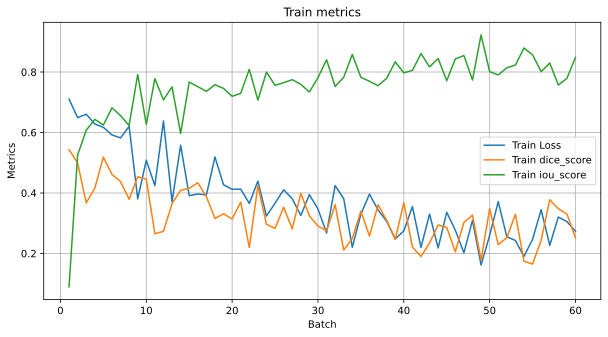

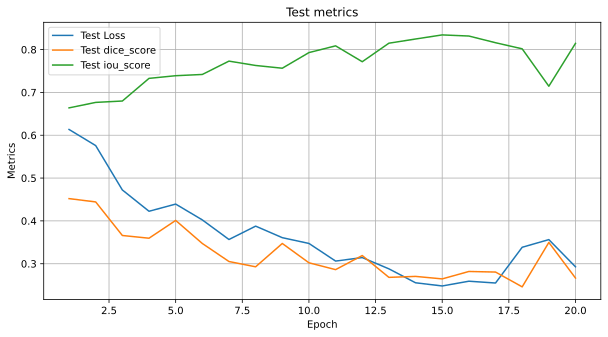

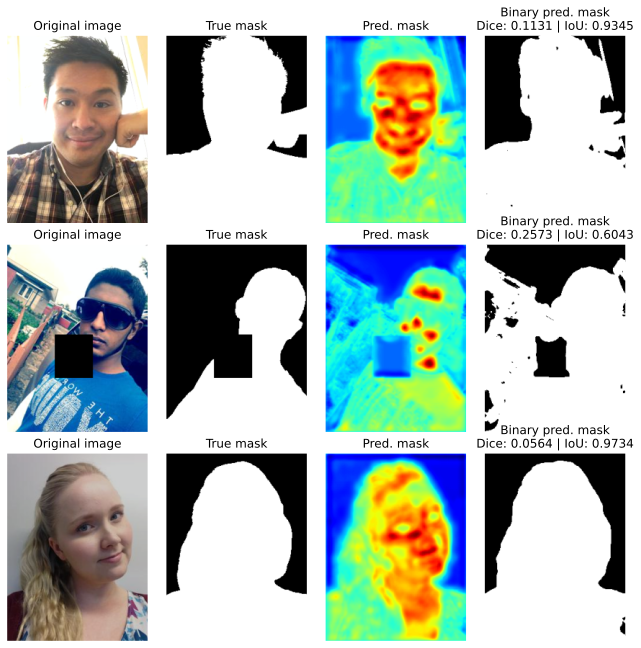

In [ ]:
train_model(model, optimizer, loss_function=bce_loss, model_name=model_name, train_loader=train_data_loader, writer=writer, num_epochs=hparams['num_epochs'])
writer.close()

Функция потерь -- **Dice Loss**

In [ ]:
model_name = 'LinkNet_DiceLoss'
torch.cuda.empty_cache()
writer = SummaryWriter(f'runs/{model_name}_{time.ctime()}')
hparams = {
    'model_name': 'LinkNet',
    'num_classes': 1,
    'num_blocks': 3,
    'num_epochs': 20,
    'lr': 1e-3,
    'loss_function': 'DiceLoss'
}
writer.add_hparams(hparams, {})

model = LinkNet(num_classes=hparams['num_classes'], num_blocks=hparams['num_blocks']).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=hparams['lr'])

inputs = torch.randn(1, 3, 224, 224).to(device)
writer.add_graph(model, inputs)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 3 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Epoch 1/20, Loss: 0.4504, Dice: 0.4504, IoU: 0.5331, time: 18.1 s.


Epoch 2/20, Loss: 0.3378, Dice: 0.3378, IoU: 0.5771, time: 9.1 s.


Epoch 3/20, Loss: 0.3450, Dice: 0.3450, IoU: 0.5695, time: 7.9 s.


Epoch 4/20, Loss: 0.3575, Dice: 0.3575, IoU: 0.5579, time: 9.0 s.


Epoch 5/20, Loss: 0.3359, Dice: 0.3359, IoU: 0.5786, time: 8.9 s.


Epoch 6/20, Loss: 0.3433, Dice: 0.3433, IoU: 0.5707, time: 7.7 s.


Epoch 7/20, Loss: 0.3571, Dice: 0.3571, IoU: 0.5561, time: 8.7 s.


Epoch 8/20, Loss: 0.3461, Dice: 0.3461, IoU: 0.5682, time: 8.7 s.


Epoch 9/20, Loss: 0.3445, Dice: 0.3445, IoU: 0.5696, time: 7.9 s.


Epoch 10/20, Loss: 0.3505, Dice: 0.3505, IoU: 0.5624, time: 8.8 s.


Epoch 11/20, Loss: 0.3448, Dice: 0.3448, IoU: 0.5679, time: 8.8 s.


Epoch 12/20, Loss: 0.3491, Dice: 0.3491, IoU: 0.5649, time: 8.5 s.


Epoch 13/20, Loss: 0.3501, Dice: 0.3501, IoU: 0.5620, time: 7.9 s.


Epoch 14/20, Loss: 0.3579, Dice: 0.3579, IoU: 0.5515, time: 9.4 s.


Epoch 15/20, Loss: 0.3519, Dice: 0.3519, IoU: 0.5642, time: 8.7 s.


Epoch 16/20, Loss: 0.3426, Dice: 0.3426, IoU: 0.5712, time: 7.7 s.


Epoch 17/20, Loss: 0.3510, Dice: 0.3510, IoU: 0.5633, time: 8.6 s.


Epoch 18/20, Loss: 0.3536, Dice: 0.3536, IoU: 0.5584, time: 9.7 s.


Epoch 19/20, Loss: 0.3517, Dice: 0.3517, IoU: 0.5595, time: 8.6 s.


Epoch 20/20, Loss: 0.3454, Dice: 0.3454, IoU: 0.5701, time: 8.2 s.
Best model loaded from checkpoint: LinkNet_DiceLoss_best_model.pth
Best model achieved at Epoch 19 with Val Loss: 0.3357. Total time: 181.1 s.


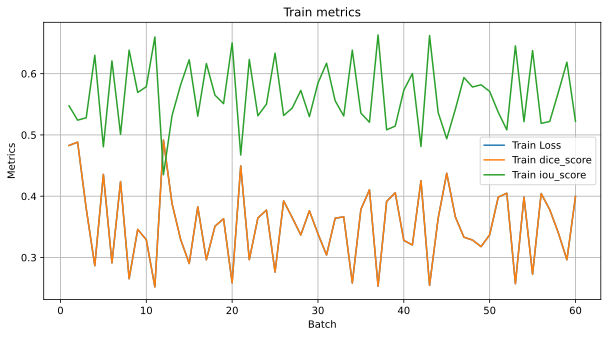

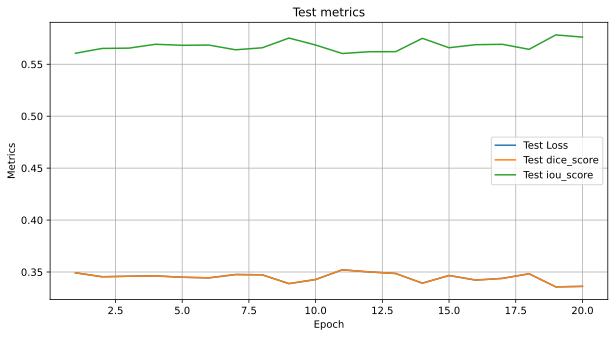

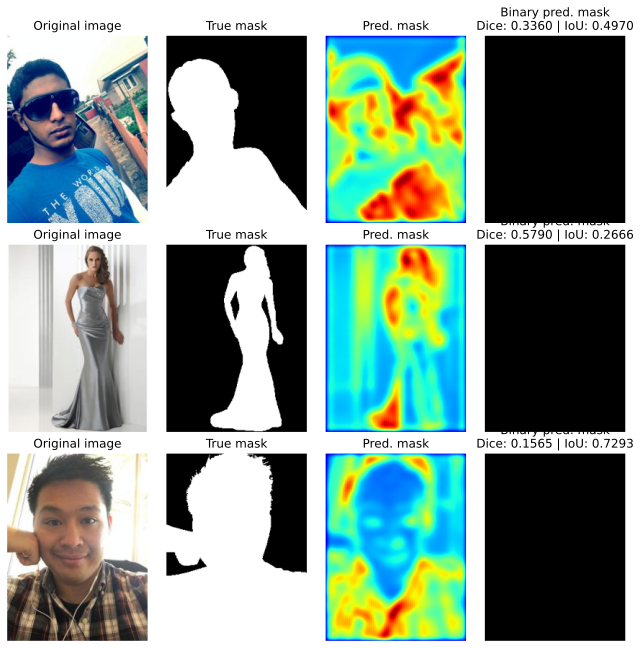

In [ ]:
train_model(model, optimizer, loss_function=DiceLoss(reduction='mean'), model_name=model_name, train_loader=train_data_loader, writer=writer, num_epochs=hparams['num_epochs'])
writer.close()

Функция потерь -- среднее из **Binary Cross Entropy** и **Dice Loss**

In [ ]:
model_name = 'LinkNet_0.5_BCE_0.5_Dice'
torch.cuda.empty_cache()
writer = SummaryWriter(f'runs/{model_name}_{time.ctime()}')
hparams = {
    'model_name': 'LinkNet',
    'num_classes': 1,
    'num_blocks': 3,
    'num_epochs': 20,
    'lr': 1e-3,
    'loss_function': '0.5 BCE Loss + 0.5 Dice Loss'
}
writer.add_hparams(hparams, {})

model = LinkNet(num_classes=hparams['num_classes'], num_blocks=hparams['num_blocks']).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=hparams['lr'])

inputs = torch.randn(1, 3, 224, 224).to(device)
writer.add_graph(model, inputs)

weights = (0.5, 0.5)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 3 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Epoch 1/20, Loss: 0.5720, Dice: 0.4508, IoU: 0.4611, time: 9.1 s.


Epoch 2/20, Loss: 0.5425, Dice: 0.4396, IoU: 0.5583, time: 8.0 s.


Epoch 3/20, Loss: 0.5015, Dice: 0.4152, IoU: 0.6584, time: 8.9 s.


Epoch 4/20, Loss: 0.5082, Dice: 0.3792, IoU: 0.6511, time: 11.4 s.


Epoch 5/20, Loss: 0.4788, Dice: 0.3280, IoU: 0.7060, time: 8.7 s.


Epoch 6/20, Loss: 0.4841, Dice: 0.3965, IoU: 0.6924, time: 9.0 s.


Epoch 7/20, Loss: 0.4793, Dice: 0.4311, IoU: 0.7050, time: 8.9 s.


Epoch 8/20, Loss: 0.4289, Dice: 0.3838, IoU: 0.7190, time: 8.9 s.


Epoch 9/20, Loss: 0.4241, Dice: 0.3310, IoU: 0.7432, time: 9.3 s.


Epoch 10/20, Loss: 0.4247, Dice: 0.3024, IoU: 0.7282, time: 8.6 s.


Epoch 11/20, Loss: 0.3891, Dice: 0.3162, IoU: 0.7582, time: 9.7 s.


Epoch 12/20, Loss: 0.3472, Dice: 0.3112, IoU: 0.7774, time: 9.0 s.


Epoch 13/20, Loss: 0.3551, Dice: 0.3147, IoU: 0.7621, time: 8.9 s.


Epoch 14/20, Loss: 0.3477, Dice: 0.2987, IoU: 0.7742, time: 8.6 s.


Epoch 15/20, Loss: 0.3414, Dice: 0.2902, IoU: 0.7769, time: 8.9 s.


Epoch 16/20, Loss: 0.3058, Dice: 0.2827, IoU: 0.7979, time: 8.1 s.


Epoch 17/20, Loss: 0.2954, Dice: 0.2697, IoU: 0.7941, time: 9.6 s.


Epoch 18/20, Loss: 0.2734, Dice: 0.2578, IoU: 0.8121, time: 8.9 s.


Epoch 19/20, Loss: 0.3128, Dice: 0.2531, IoU: 0.8111, time: 8.8 s.


Epoch 20/20, Loss: 0.3051, Dice: 0.3018, IoU: 0.8014, time: 8.3 s.
Best model loaded from checkpoint: LinkNet_0.5_BCE_0.5_Dice_best_model.pth
Best model achieved at Epoch 15 with Val Loss: 0.2954. Total time: 179.5 s.


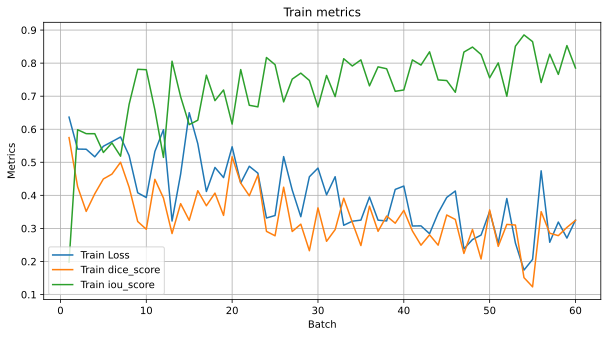

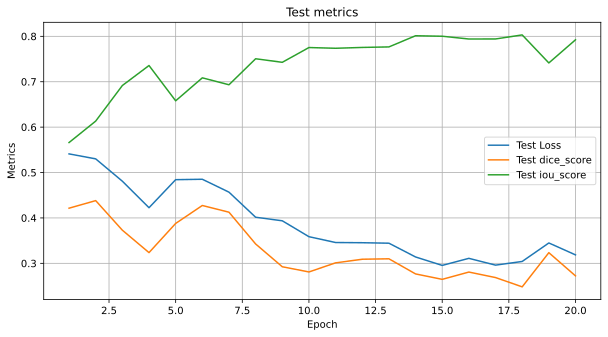

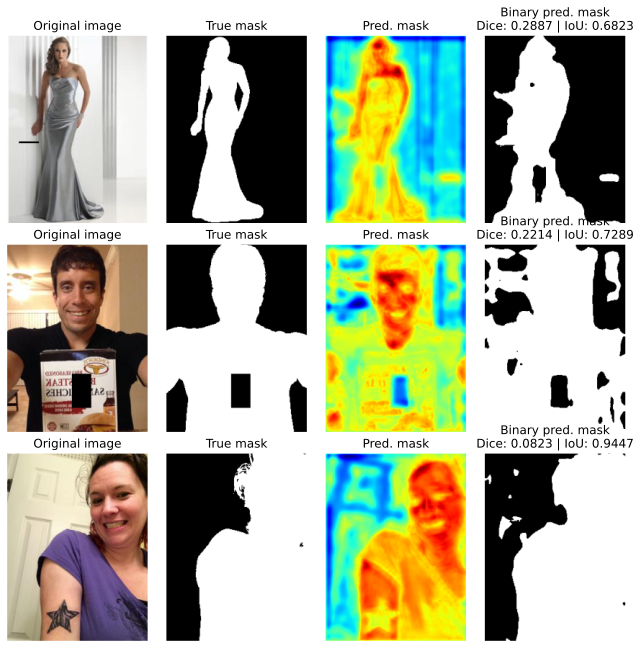

In [ ]:
train_model(model, optimizer, loss_function=dice_and_bce_loss, model_name=model_name, train_loader=train_data_loader, writer=writer, num_epochs=hparams['num_epochs'])
writer.close()

Функция потерь -- 80% **Binary Cross Entropy** и 20% **Dice Loss**

In [ ]:
model_name = 'LinkNet_0.8_BCE_0.2_Dice'
torch.cuda.empty_cache()
writer = SummaryWriter(f'runs/{model_name}_{time.ctime()}')
hparams = {
    'model_name': 'LinkNet',
    'num_classes': 1,
    'num_blocks': 3,
    'num_epochs': 20,
    'lr': 1e-3,
    'loss_function': '0.8 BCE Loss + 0.2 Dice Loss'
}
writer.add_hparams(hparams, {})

model = LinkNet(num_classes=hparams['num_classes'], num_blocks=hparams['num_blocks']).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=hparams['lr'])

inputs = torch.randn(1, 3, 224, 224).to(device)
writer.add_graph(model, inputs)

weights = (0.8, 0.2)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 3 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Epoch 1/20, Loss: 0.6154, Dice: 0.4676, IoU: 0.5422, time: 8.7 s.


Epoch 2/20, Loss: 0.5861, Dice: 0.4105, IoU: 0.5983, time: 11.9 s.


Epoch 3/20, Loss: 0.5620, Dice: 0.4484, IoU: 0.6513, time: 9.2 s.


Epoch 4/20, Loss: 0.5145, Dice: 0.3955, IoU: 0.6696, time: 9.7 s.


Epoch 5/20, Loss: 0.4742, Dice: 0.3322, IoU: 0.7334, time: 8.4 s.


Epoch 6/20, Loss: 0.4454, Dice: 0.3839, IoU: 0.6996, time: 9.9 s.


Epoch 7/20, Loss: 0.4244, Dice: 0.3664, IoU: 0.7332, time: 9.6 s.


Epoch 8/20, Loss: 0.4321, Dice: 0.3076, IoU: 0.7609, time: 9.1 s.


Epoch 9/20, Loss: 0.3895, Dice: 0.3223, IoU: 0.7497, time: 8.7 s.


Epoch 10/20, Loss: 0.3810, Dice: 0.3683, IoU: 0.7585, time: 9.6 s.


Epoch 11/20, Loss: 0.3379, Dice: 0.3257, IoU: 0.7951, time: 9.1 s.


Epoch 12/20, Loss: 0.3548, Dice: 0.2785, IoU: 0.7771, time: 8.7 s.


Epoch 13/20, Loss: 0.3105, Dice: 0.2922, IoU: 0.7936, time: 8.6 s.


Epoch 14/20, Loss: 0.3085, Dice: 0.2810, IoU: 0.8010, time: 9.7 s.


Epoch 15/20, Loss: 0.2890, Dice: 0.2741, IoU: 0.7925, time: 8.8 s.


Epoch 16/20, Loss: 0.2690, Dice: 0.2511, IoU: 0.8236, time: 8.2 s.


Epoch 17/20, Loss: 0.2801, Dice: 0.2699, IoU: 0.8196, time: 8.8 s.


Epoch 18/20, Loss: 0.2715, Dice: 0.2683, IoU: 0.8073, time: 10.4 s.


Epoch 19/20, Loss: 0.2554, Dice: 0.2288, IoU: 0.8422, time: 8.9 s.


Epoch 20/20, Loss: 0.2640, Dice: 0.2772, IoU: 0.8104, time: 8.3 s.
Best model loaded from checkpoint: LinkNet_0.8_BCE_0.2_Dice_best_model.pth
Best model achieved at Epoch 18 with Val Loss: 0.2382. Total time: 184.2 s.


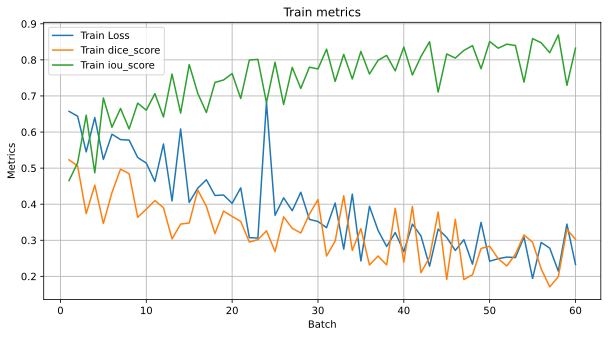

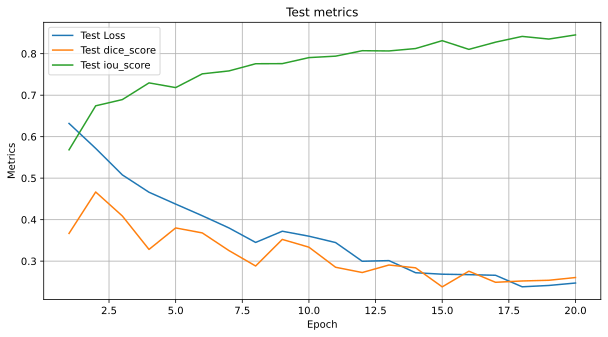

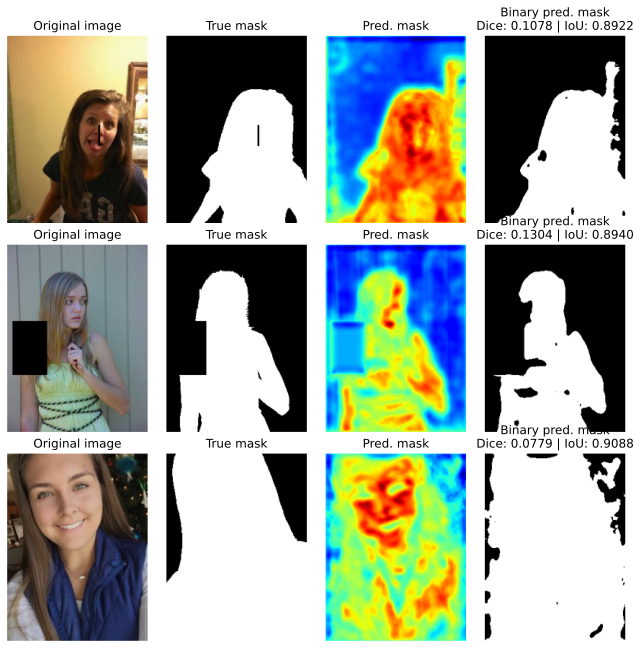

In [ ]:
train_model(model, optimizer, loss_function=dice_and_bce_loss, model_name=model_name, train_loader=train_data_loader, writer=writer, num_epochs=hparams['num_epochs'])
writer.close()

Функция потерь -- 20% **Binary Cross Entropy** и 80% **Dice Loss**

In [ ]:
model_name = 'LinkNet_0.2_BCE_0.8_Dice'
torch.cuda.empty_cache()
writer = SummaryWriter(f'runs/{model_name}_{time.ctime()}')
hparams = {
    'model_name': 'LinkNet',
    'num_classes': 1,
    'num_blocks': 3,
    'num_epochs': 20,
    'lr': 1e-3,
    'loss_function': '0.2 BCE Loss + 0.8 Dice Loss'
}
writer.add_hparams(hparams, {})

model = LinkNet(num_classes=hparams['num_classes'], num_blocks=hparams['num_blocks']).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=hparams['lr'])

inputs = torch.randn(1, 3, 224, 224).to(device)
writer.add_graph(model, inputs)

weights = (0.2, 0.8)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 3 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Epoch 1/20, Loss: 0.5373, Dice: 0.4998, IoU: 0.3617, time: 8.5 s.


Epoch 2/20, Loss: 0.4818, Dice: 0.3705, IoU: 0.5647, time: 8.7 s.


Epoch 3/20, Loss: 0.4578, Dice: 0.4084, IoU: 0.5714, time: 9.1 s.


Epoch 4/20, Loss: 0.4406, Dice: 0.3774, IoU: 0.5753, time: 11.6 s.


Epoch 5/20, Loss: 0.4415, Dice: 0.3682, IoU: 0.5892, time: 8.6 s.


Epoch 6/20, Loss: 0.4394, Dice: 0.3812, IoU: 0.5812, time: 9.3 s.


Epoch 7/20, Loss: 0.4256, Dice: 0.3559, IoU: 0.6412, time: 9.5 s.


Epoch 8/20, Loss: 0.4144, Dice: 0.3638, IoU: 0.6588, time: 9.2 s.


Epoch 9/20, Loss: 0.3871, Dice: 0.3509, IoU: 0.7193, time: 9.3 s.


Epoch 10/20, Loss: 0.3876, Dice: 0.3276, IoU: 0.7027, time: 8.8 s.


Epoch 11/20, Loss: 0.3766, Dice: 0.3397, IoU: 0.7348, time: 9.1 s.


Epoch 12/20, Loss: 0.3431, Dice: 0.3025, IoU: 0.7511, time: 8.9 s.


Epoch 13/20, Loss: 0.2984, Dice: 0.2637, IoU: 0.7796, time: 9.5 s.


Epoch 14/20, Loss: 0.3056, Dice: 0.2618, IoU: 0.7676, time: 9.0 s.


Epoch 15/20, Loss: 0.2958, Dice: 0.2628, IoU: 0.7867, time: 8.9 s.


Epoch 16/20, Loss: 0.3369, Dice: 0.2839, IoU: 0.7422, time: 8.4 s.


Epoch 17/20, Loss: 0.2994, Dice: 0.2877, IoU: 0.7802, time: 9.9 s.


Epoch 18/20, Loss: 0.2774, Dice: 0.2566, IoU: 0.7909, time: 9.3 s.


Epoch 19/20, Loss: 0.2968, Dice: 0.2386, IoU: 0.7978, time: 9.1 s.


Epoch 20/20, Loss: 0.2647, Dice: 0.2337, IoU: 0.8185, time: 8.3 s.
Best model loaded from checkpoint: LinkNet_0.2_BCE_0.8_Dice_best_model.pth
Best model achieved at Epoch 20 with Val Loss: 0.2508. Total time: 183.0 s.


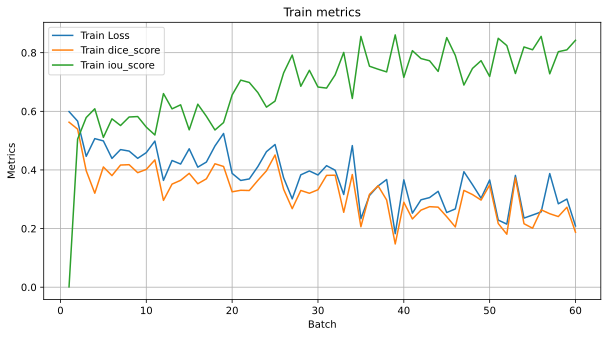

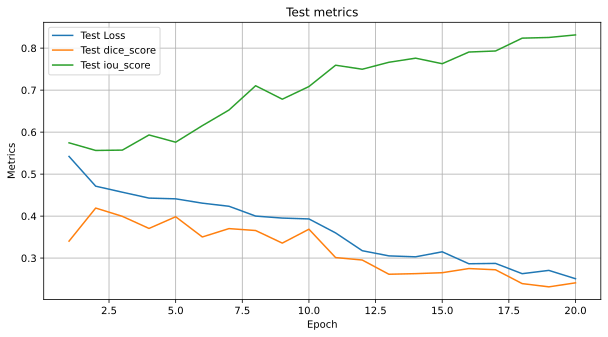

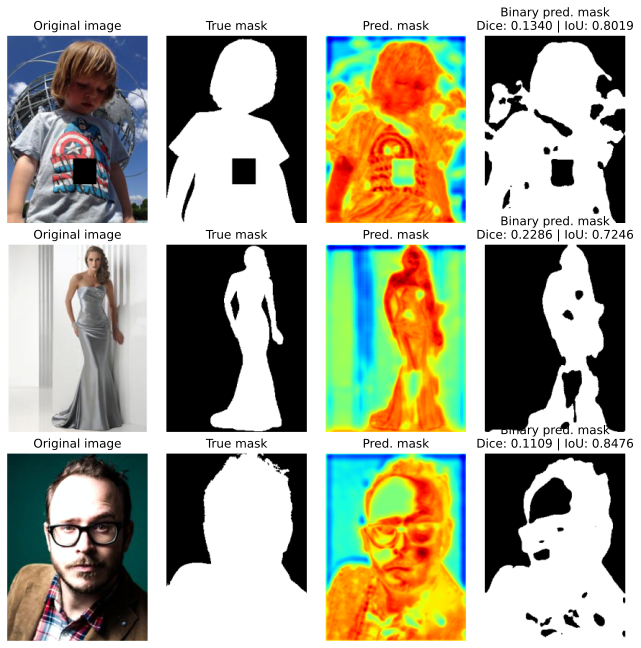

In [ ]:
train_model(model, optimizer, loss_function=dice_and_bce_loss, model_name=model_name, train_loader=train_data_loader, writer=writer, num_epochs=hparams['num_epochs'])
writer.close()

- Мы наблюдаем, что архитектура LinkNet на всех функциях потерь демонстрирует результаты, которые хуже, чем UNet. Это объясняется тем, что UNet имеет более сложную архитектуру по сравнению с LinkNet, основанную на количестве параметров. Глубокие сети обычно способны извлекать более сложные признаки изображений.

## `Теоретические вопросы (1 балл)`

### `Вопрос 1`
* Сформулируйте два предположения о структуре входных данных, на которые опирается архитектура свёрточных сетей.
* Какие преимущества дает использование сверток в случае, если эти предположения верные?
* Приведите пример входных данных, когда эти предположения не выполняются.

**Параметрическая стационарность.**

Сверточные нейронные сети предполагают, что статистические свойства данных остаются постоянными в разных областях изображения. Это предположение является основой для использования одних и тех же сверток в разных частях изображения.

Использование одних и тех же сверток в разных областях изображения позволяет сети обучаться на небольшом количестве параметров, что снижает риск переобучения и повышает обобщающую способность модели.

Там, где связи между элементами могут быть далеки или не иметь пространственной структуры, предположение нарушается

**Локальность данных.**

Сверточные нейронные сети предполагают, что данные, подаваемые на вход, обладают локальной структурой, то есть близкие по значению пиксели на изображении скорее всего связаны с соседними пикселями, чем с пикселями на большом расстоянии

Свертки позволяют архитектуре нейронной сети извлекать иерархические признаки из изображений, учитывая локальную структуру данных. Это позволяет сети эффективно выявлять и анализировать различные характеристики объектов на изображениях, такие как грани, текстуры и формы.

Если входные данные не обладают локальной структурой, например, если каждый пиксель изображения независим от остальных, то принцип нарушается

### `Вопрос 2`
Пусть дано множество 1-D входов ${x^{(i)} \in \mathbb{R}^{100}}$.

Рассмотрим полносвязный слой ${f(\cdot)}$, заданный как ${f(x^{(i)}) = \sigma(Wx^{(i)})}$, где ${W}$ - матрица весов размерности ${1000\times 100}$ и ${\sigma(\cdot)}$ поэлементая функция активации.

Рассмотрим также сверточный слой ${g(\cdot)}$ с десятью картами признаков: ${g(x^{(i)}) = \sigma([z_1, z_2,...,z_{10}])}$, где ${z_j = x^{(i)}\ast w_j}$ для некоторого ядра свертки ${w_j}$ с размером 3 и паддингом 1. Для ${f(\cdot)}$ и ${g(\cdot)}$ напишите:

1. Размерность выходного пространства.
2. Количество обучаемых параметров.
3. Число операций при выполнении forward pass (при условии наивной реализации перемножения матриц и вычисления сверток).

1. Размерность выходного вектора будет равна числу нейронов в слое (т.е. $1000 \times 100$)

2. $1000 \times 100 = 100000$ обучаемых параметров.

3. $1000 \times 100 $ умножений + $1000 \times 99$ сложений и $1000 \times 1$ вычеслений сигмоиды, т.е. $200000$ операций

*Ваш ответ в этой ячейке*

## `Бонус: постобработка изображений (1 балл)`

В предложенной задаче на фотографиях необходимо сегментировать только центральное изображения. Артефакты, которые появляются на краях изображения, можно удалять с помощью постобработки (например, с помощью модуля [skimage.morphology](https://scikit-image.org/docs/dev/api/skimage.morphology.html)).

Реализуйте какой-нибудь из методов постобработки, дающий прирост в качестве. Продемонстрируйте несколько изображений, на которых постобработка будет оказывать влияние на результат сегментации.

## `Бонус: существенное улучшение качества (2 балла)`

Придумайте какой-нибудь трюк, который существенно (с учётом бонусного пункта 1) повысит качество (которое должно быть и так достаточно высоко). Не разрешается использовать дополнительные данные или другие предобученные кодировщики кроме VGG13.

Если вы что-то попробовали, но качество не повысилось, всё равно оформите этот пункт, даже за неудачные попытки могут быть начислены баллы.

## `Бонус: обучение с использованием сторонних фреймворков (1 балл)`

Попробуйте обучить свою модель с использованием одного из следующих фреймворков: [catalyst](https://github.com/catalyst-team/catalyst), [pytorch-lightning](https://www.pytorchlightning.ai/), [ignite](https://github.com/pytorch/ignite).

## `Бонус: аугментации (0.5 балла)`

Воспользуйтесь сторонними библиотеками для аугментаций, например, [deepaugment](https://github.com/barisozmen/deepaugment) и [albumentations](https://albumentations.ai/) для улучшения качества модели.

## `Бонус: torch.compile (0.25 балла)`

Попробуйте установить [Pytorch 2.0](https://pytorch.org/get-started/pytorch-2.0/) и запустите обучение с использованием `torch.compile`. Тщательно сравните время с и без использованием компиляции.

*Замечание:* обязательно укажите конфигурацию системы (версия OS, модель CPU/GPU, объём RAM), на которой производилось обучение. В частности, приложите вывод команд:
```bash
! nvcc --version
! nvidia-smi
```